In [140]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import keras
from keras.models import Sequential
from keras.layers import Dense, Conv2D , MaxPool2D , Flatten , Dropout , BatchNormalization
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report,confusion_matrix, f1_score, balanced_accuracy_score
from skimage.metrics import structural_similarity as ssim
from scipy.stats import spearmanr
from keras.callbacks import ReduceLROnPlateau
import cv2 # pip install opencv-python
import os

In [141]:
from tensorflow.keras import backend as K
import gc
K.clear_session()
gc.collect() 

0

Description of the Pneumonia Dataset

The dataset is organized into 3 folders (train, test, val) and contains subfolders for each image category (Pneumonia/Normal). There are 5,863 X-Ray images (JPEG) and 2 categories (Pneumonia/Normal). Chest X-ray images (anterior-posterior) were selected from retrospective cohorts of pediatric patients of one to five years old from Guangzhou Women and Children’s Medical Center, Guangzhou. All chest X-ray imaging was performed as part of patients’ routine clinical care. For the analysis of chest x-ray images, all chest radiographs were initially screened for quality control by removing all low quality or unreadable scans. The diagnoses for the images were then graded by two expert physicians before being cleared for training the AI system. In order to account for any grading errors, the evaluation set was also checked by a third expert.

In [142]:
labels = ['NORMAL', 'PNEUMONIA']
img_size = 150
def get_training_data(data_dir):
    data = []  # Image data
    labels_list = []  # Label data
    
    for label in labels:
        path = os.path.join(data_dir, label)
        class_num = labels.index(label)
        for img in os.listdir(path):
            try:
                img_arr = cv2.imread(os.path.join(path, img), cv2.IMREAD_GRAYSCALE)
                resized_arr = cv2.resize(img_arr, (img_size, img_size))  # Reshaping images to preferred size
                data.append(resized_arr)  # Add the image to the data list
                labels_list.append(class_num)  # Add the corresponding label
            except Exception as e:
                print(e)

    # Convert lists to numpy arrays and return as a tuple
    return np.array(data), np.array(labels_list)


Loading the Dataset

In [143]:
train_data, train_labels  = get_training_data('chest_xray/chest_xray/train')
test_data, test_labels = get_training_data('chest_xray/test')
val_data, val_labels = get_training_data('chest_xray/val')

OpenCV(4.11.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\resize.cpp:4208: error: (-215:Assertion failed) !ssize.empty() in function 'cv::resize'

OpenCV(4.11.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\resize.cpp:4208: error: (-215:Assertion failed) !ssize.empty() in function 'cv::resize'



In [144]:
train_data.shape
train_data
train_data[[1]]
train_labels

array([0, 0, 0, ..., 1, 1, 1])

Data Visualization & Preprocessing

The data seems imbalanced . To increase the no. of training examples, we could use use data augmentation.

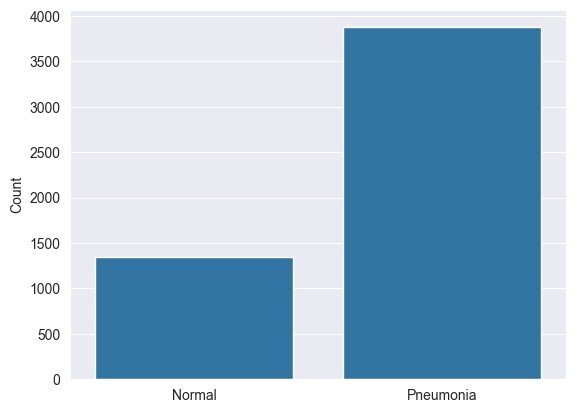

In [145]:
label_map = {1: "Pneumonia", 0: "Normal"}
l = [label_map[label] for label in train_labels]

sns.set_style('darkgrid')
sns.countplot(x=l)
plt.ylabel("Count")
plt.show()

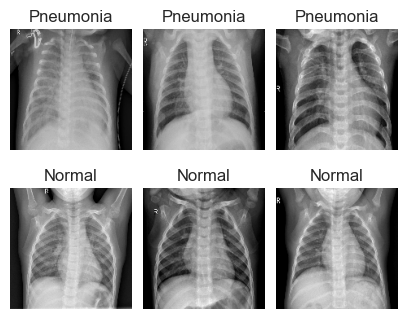

In [146]:
# Separate images based on their labels
pneumonia_images = [train_data[i] for i in range(len(train_labels)) if train_labels[i] == 1]
normal_images = [train_data[i] for i in range(len(train_labels)) if train_labels[i] == 0]

# Plot 3 Pneumonia images
plt.figure(figsize=(5, 5))
for i in range(3):
    plt.subplot(2, 3, i+1)  # 2 rows, 3 columns, i+1th subplot
    plt.imshow(pneumonia_images[i].reshape(img_size, img_size), cmap='gray')
    plt.title("Pneumonia")
    plt.axis('off')  # Hide axes

# Plot 3 Normal images
for i in range(3):
    plt.subplot(2, 3, i+4)  # 2 rows, 3 columns, i+4th subplot
    plt.imshow(normal_images[i].reshape(img_size, img_size), cmap='gray')
    plt.title("Normal")
    plt.axis('off')  # Hide axes

plt.subplots_adjust(hspace=-0.3, wspace=0.1)
plt.show()

We perform a grayscale normalization to reduce the effect of illumination's differences.Moreover the CNN converges faster on [0..1] data than on [0..255].

In [147]:
# Normalize the data
x_train = np.array(train_data) / 255
x_val = np.array(val_data) / 255
x_test = np.array(test_data) / 255

In [148]:
x_test

array([[[0.14117647, 0.1254902 , 0.1254902 , ..., 0.1254902 ,
         0.1372549 , 0.12941176],
        [0.11764706, 0.11764706, 0.11764706, ..., 0.11764706,
         0.11372549, 0.12156863],
        [0.13333333, 0.1254902 , 0.1254902 , ..., 0.1254902 ,
         0.1254902 , 0.1254902 ],
        ...,
        [0.12156863, 0.10588235, 0.11372549, ..., 0.11764706,
         0.12941176, 0.1372549 ],
        [0.11764706, 0.11372549, 0.10196078, ..., 0.13333333,
         0.13333333, 0.1254902 ],
        [0.11372549, 0.10980392, 0.11372549, ..., 0.12156863,
         0.11372549, 0.14117647]],

       [[0.1372549 , 0.1254902 , 0.10196078, ..., 0.48627451,
         0.45098039, 0.41960784],
        [0.15686275, 0.12156863, 0.10588235, ..., 0.47058824,
         0.45882353, 0.40784314],
        [0.15294118, 0.13333333, 0.10588235, ..., 0.47843137,
         0.4627451 , 0.40784314],
        ...,
        [0.16862745, 0.14901961, 0.17254902, ..., 0.11764706,
         0.14117647, 0.11764706],
        [0.1

Summary of Why This is Necessary:
Reshaping Image Data: The deep learning model needs the image data in the format (num_samples, height, width, channels) to work with convolution layers effectively. Grayscale images need to have a channel dimension (which is 1), so they are reshaped accordingly.

Converting Labels to NumPy Arrays: Deep learning frameworks need labels in a numerical format (as NumPy arrays or tensors), and they must be able to index and manipulate the labels efficiently during training and evaluation.

What Happens After Reshaping:
After this block of code, your data will be in the proper format:

x_train, x_val, x_test: 4D arrays of shape (num_samples, img_size, img_size, 1), suitable for feeding into a neural network.

y_train, y_val, y_test: 1D arrays containing the labels, which are also ready to be used for training or evaluation.

In [149]:
# resize data for deep learning 
x_train = x_train.reshape(-1, img_size, img_size, 1)
y_train = np.array(train_labels)

x_val = x_val.reshape(-1, img_size, img_size, 1)
y_val = np.array(val_labels)

x_test = x_test.reshape(-1, img_size, img_size, 1)
y_test = np.array(test_labels)

In [150]:
x_train.shape # 5216 images, each 150x150 pixels, with 1 channel for grayscale

(5216, 150, 150, 1)

In [105]:
# With data augmentation to prevent overfitting and handling the imbalance in dataset
datagen = ImageDataGenerator(
        featurewise_center=False,  # set input mean to 0 over the dataset
        samplewise_center=False,  # set each sample mean to 0
        featurewise_std_normalization=False,  # divide inputs by std of the dataset
        samplewise_std_normalization=False,  # divide each input by its std
        zca_whitening=False,  # apply ZCA whitening
        rotation_range = 30,  # randomly rotate images in the range (degrees, 0 to 180)
        zoom_range = 0.2, # Randomly zoom image 
        width_shift_range=0.1,  # randomly shift images horizontally (fraction of total width)
        height_shift_range=0.1,  # randomly shift images vertically (fraction of total height)
        horizontal_flip = True,  # randomly flip images
        vertical_flip=False)  # randomly flip images


datagen.fit(x_train)

This model is a Convolutional Neural Network (CNN) designed for binary classification tasks, typically used in image classification. It consists of several layers aimed at extracting features from input images:

1. **Convolutional Layers**: The model uses multiple convolutional layers with increasing numbers of filters (32, 64, 128, 256), each applying 3x3 kernels to extract spatial features. These layers help in identifying patterns such as edges, textures, and more complex shapes in the images.

2. **Max-Pooling Layers**: After each convolutional block, max-pooling is applied to reduce the spatial dimensions of the feature maps, which helps in reducing computational load and controlling overfitting. The pooling size is 2x2 with a stride of 2.

3. **Batch Normalization**: This layer is used after each convolutional block to normalize the activations, which helps speed up training and stabilizes the learning process.

4. **Dropout Layers**: Dropout is used in several layers (0.1 or 0.2) to prevent overfitting. It randomly deactivates a fraction of neurons during training, forcing the model to generalize better.

5. **Flattening**: After feature extraction, the 2D feature maps are flattened into a 1D vector to be fed into fully connected (dense) layers.

6. **Dense Layers**: The model has one fully connected layer with 128 units and a ReLU activation function, followed by another dropout layer to improve generalization. The output layer is a single neuron with a sigmoid activation function, providing a probability value between 0 and 1 for binary classification.

7. **Model Compilation**: The model uses the RMSprop optimizer and binary crossentropy loss function, which are appropriate for binary classification problems. The metric used for evaluation is accuracy.

Overall, this CNN model is structured to extract hierarchical features from input images and classify them into two categories with high accuracy, using techniques like batch normalization, dropout, and max-pooling to improve training efficiency and prevent overfitting.

In [118]:
model = Sequential()
model.add(Conv2D(32 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu' , input_shape = (150,150,1)))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
model.add(Conv2D(64 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu'))
model.add(Dropout(0.1))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
model.add(Conv2D(64 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu'))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
model.add(Conv2D(128 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu'))
model.add(Dropout(0.2))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
model.add(Conv2D(256 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu'))
model.add(Dropout(0.2))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
model.add(Flatten())
model.add(Dense(units = 128 , activation = 'relu'))
model.add(Dropout(0.2))
model.add(Dense(units = 1 , activation = 'sigmoid'))
model.compile(optimizer = "rmsprop" , loss = 'binary_crossentropy' , metrics = ['accuracy'])
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 150, 150, 32)   │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 150, 150, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 75, 75, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 75, 75, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 75, 75, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 75, 75, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 38, 38, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 38, 38, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 19, 19, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 19, 19, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 19, 19, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 19, 19, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 10, 10, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 10, 10, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 10, 10, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 10, 10, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 5, 5, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 6400)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │       819,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴─────────────

 Total params: 1,246,401 (4.75 MB)

 Trainable params: 1,245,313 (4.75 MB)

 Non-trainable params: 1,088 (4.25 KB)

In [119]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 150, 150, 32)   │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 150, 150, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 75, 75, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 75, 75, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 75, 75, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 75, 75, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 38, 38, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 38, 38, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 19, 19, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 19, 19, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 19, 19, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 19, 19, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 10, 10, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 10, 10, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 10, 10, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 10, 10, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 5, 5, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 6400)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │       819,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴─────────────

 Total params: 1,246,401 (4.75 MB)

 Trainable params: 1,245,313 (4.75 MB)

 Non-trainable params: 1,088 (4.25 KB)

In [ ]:
#model_ran = model
#model_ran.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 150, 150, 32)   │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 150, 150, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 75, 75, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 75, 75, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 75, 75, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 75, 75, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 38, 38, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 38, 38, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 19, 19, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 19, 19, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 19, 19, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 19, 19, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 10, 10, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 10, 10, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 10, 10, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 10, 10, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 5, 5, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 6400)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │       819,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴─────────────

 Total params: 1,246,401 (4.75 MB)

 Trainable params: 1,245,313 (4.75 MB)

 Non-trainable params: 1,088 (4.25 KB)

Model might be trained.
[array([[[[ 0.08583237,  0.03539351,  0.02762157, -0.098086  ,
           0.04615161, -0.10266709,  0.10703401,  0.09551848,
          -0.03294501, -0.08127663, -0.05890498,  0.0593304 ,
           0.11260332,  0.06949626,  0.06415786, -0.05131903,
           0.08601286,  0.07653202,  0.0080393 ,  0.10440378,
          -0.09163212, -0.036509  ,  0.03326425, -0.10130608,
           0.09410928,  0.02505407, -0.02337807, -0.0059171 ,
          -0.13928132, -0.06377462, -0.05733606, -0.09061096]],

        [[ 0.0156163 , -0.12689394,  0.02404137,  0.12098442,
           0.03749882,  0.04397286, -0.07415029, -0.11938657,
           0.12322231,  0.03810768,  0.12330337, -0.01222788,
          -0.10443018,  0.04980321,  0.01845698, -0.04824585,
          -0.14075938,  0.06086299,  0.08313549,  0.13767947,
          -0.11989735,  0.06638923,  0.11272989,  0.00535084,
          -0.0673859 ,  0.04237643, -0.09294122,  0.02361247,
           0.13398089,  0.04808156, -0.055

In [121]:
learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', patience = 2, verbose=1,factor=0.3, min_lr=0.000001)

In [ ]:
bool_train_cnn = False
if bool_train_cnn:
    trained_model_cnn = model.fit(datagen.flow(x_train,y_train, batch_size = 32) ,epochs = 12 , validation_data = datagen.flow(x_val, y_val) ,callbacks = [learning_rate_reduction])
    # Save the entire model (architecture + weights + optimizer state)
    model.save('part2_cnn_model.h5')
else:
    model = keras.models.load_model('part2_cnn_model_Arjun.h5')   

Epoch 1/12


C:\Users\salom\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


163/163 ━━━━━━━━━━━━━━━━━━━━ 90s 544ms/step - accuracy: 0.7991 - loss: 1.2805 - val_accuracy: 0.5000 - val_loss: 41.1145 - learning_rate: 0.0010
Epoch 2/12
163/163 ━━━━━━━━━━━━━━━━━━━━ 135s 818ms/step - accuracy: 0.8892 - loss: 0.3089 - val_accuracy: 0.5000 - val_loss: 45.2574 - learning_rate: 0.0010
Epoch 3/12
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 644ms/step - accuracy: 0.9123 - loss: 0.2310
Epoch 3: ReduceLROnPlateau reducing learning rate to 0.0003000000142492354.
163/163 ━━━━━━━━━━━━━━━━━━━━ 112s 645ms/step - accuracy: 0.9124 - loss: 0.2309 - val_accuracy: 0.5000 - val_loss: 5.8547 - learning_rate: 0.0010
Epoch 4/12
163/163 ━━━━━━━━━━━━━━━━━━━━ 65s 398ms/step - accuracy: 0.9464 - loss: 0.1415 - val_accuracy: 0.5000 - val_loss: 15.5850 - learning_rate: 3.0000e-04
Epoch 5/12
163/163 ━━━━━━━━━━━━━━━━━━━━ 67s 410ms/step - accuracy: 0.9495 - loss: 0.1473 - val_accuracy: 0.6875 - val_loss: 0.6148 - learning_rate: 3.0000e-04
Epoch 6/12
163/163 ━━━━━━━━━━━━━━━━━━━━ 66s 403ms/step - accuracy: 0.9

In [153]:
def plot_predictions(predictions, y_test):
    """
    Plots a histogram of prediction distributions and a scatter plot of predictions vs. true labels.

    Parameters:
    - predictions: array-like, all model predictions (used for scatter plot)
    - y_test: array-like, true labels corresponding to predictions
    """

    predictions_normal = predictions[y_test == 0]
    predictions_pneumonia = predictions[y_test == 1]

    # Histogram
    plt.hist(predictions_normal, bins=20, color='blue', alpha=0.7, label='Normal')
    plt.hist(predictions_pneumonia, bins=20, color='orange', alpha=0.7, label='Pneumonia')
    plt.title("Histogram of Predictions by Label")
    plt.xlabel("Prediction Values")
    plt.ylabel("Frequency")
    plt.legend()
    plt.show()

    # Scatter plot
    plt.scatter(predictions, y_test, alpha=0.5, color='red')
    plt.title("Scatter Plot of Predictions vs True Labels")
    plt.xlabel("Prediction Values")
    plt.ylabel("True Labels")
    plt.show()


In [154]:

y_pred = (model.predict(x_test) > 0.5).astype("int32")  # Thresholding for binary classification
# Create a histogram of model_ran.predict(x_test)


predictions = model.predict(x_test)
# Split predictions by label
predictions_normal = predictions[y_test == 0]
predictions_pneumonia = predictions[y_test == 1]

loss, accuracy = model.evaluate(x_test, y_test)
f1 = f1_score(y_test, y_pred)
balanced_accuracy = balanced_accuracy_score(y_test, y_pred)
print("F1 score of the model is - " , f1)
print("Balanced Accuracy of the model is - " , balanced_accuracy, "%")

20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 64ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 62ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 62ms/step - accuracy: 0.9196 - loss: 0.2946
F1 score of the model is -  0.9367741935483871
Balanced Accuracy of the model is -  0.9183760683760684 %


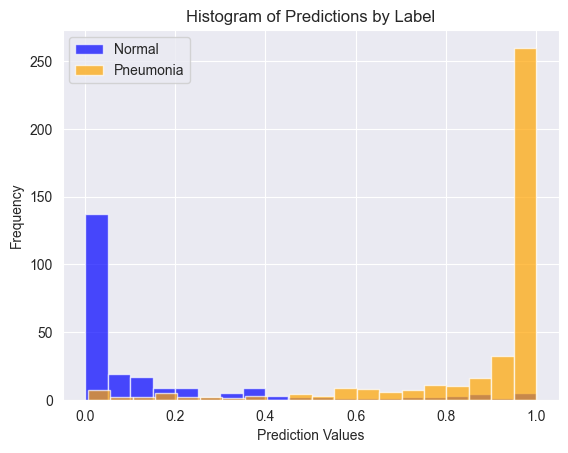

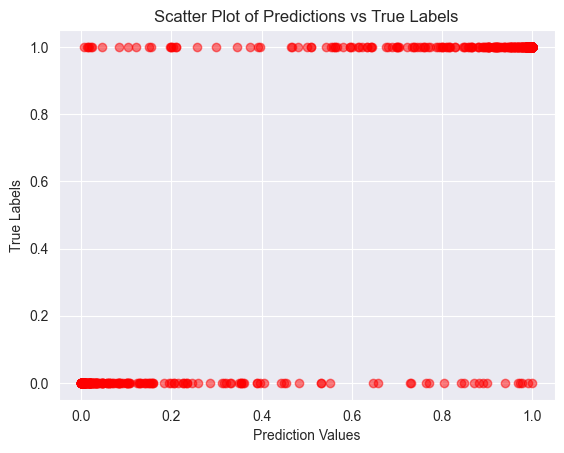

In [155]:
plot_predictions(predictions, y_test)

## GradCAM

In [48]:
import tensorflow as tf

In [49]:
model = tf.keras.models.load_model('part2_cnn_model_Arjun.h5')

In [50]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 150, 150, 32)   │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 150, 150, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 75, 75, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 75, 75, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 75, 75, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 75, 75, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 38, 38, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 38, 38, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 19, 19, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 19, 19, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 19, 19, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 19, 19, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 10, 10, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 10, 10, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 10, 10, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 10, 10, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 5, 5, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 6400)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │       819,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴─────────────

 Total params: 1,246,403 (4.75 MB)

 Trainable params: 1,245,313 (4.75 MB)

 Non-trainable params: 1,088 (4.25 KB)

 Optimizer params: 2 (12.00 B)

In [51]:
last_conv_layer = 'conv2d_4'  # Name of the last convolutional layer

In [156]:
def preprocess_image(image_path, img_size=150):
    gray = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    gray = cv2.resize(gray, (img_size, img_size))
    inp  = gray.astype(np.float32) / 255.0
    inp  = np.expand_dims(inp, axis=(0, -1))
    return inp, gray

# Function to compute and display Grad-CAM
def compute_gradcam(model, image_array, layer_name):
    grad_model = keras.models.Model(
        model.inputs, [model.get_layer(layer_name).output, model.get_layer('dense_1').output]
    )

    with tf.GradientTape() as tape:
        image_array = tf.cast(image_array, tf.float32)
        conv_outputs, predictions = grad_model(image_array)
        tape.watch(conv_outputs)
        loss = predictions[0, 0]
        print(f"Loss: {loss}")
        print(f"Predictions: {predictions}")
    
    print(f"Conv Outputs: {conv_outputs}")
    grads = tape.gradient(loss, conv_outputs)
    print(f"Grads: {grads}")
    
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2)) 

    conv_outputs = conv_outputs[0]
    
    cam = tf.reduce_sum(conv_outputs * pooled_grads, axis=-1)
    cam = tf.nn.relu(cam).numpy()

    cam -= cam.min()
    cam /= (cam.max() + 1e-8)
    cam = cv2.resize(cam, (image_array.shape[2], image_array.shape[1]))

    return cam

def display_gradcam(cam, original_img, alpha=0.2, title="Grad-CAM"):
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)
    superimposed_img = heatmap * alpha + original_img
    superimposed_img /= superimposed_img.max()

    plt.imshow(superimposed_img)
    plt.axis('off')
    plt.title(title)
    plt.show()


def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # First, we create a model that maps the input image to the activations
    # of the last conv layer as well as the output predictions
    grad_model = keras.models.Model(
        model.inputs, [model.get_layer(last_conv_layer_name).output, model.get_layer('dense_1').output]
    )

    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the last conv layer
    grads = tape.gradient(class_channel, last_conv_layer_output, unconnected_gradients=tf.UnconnectedGradients.ZERO)
    print(f"Grads: {grads}")

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()


In [157]:
def compute_gradcam(model, image_array, conv_layer_name, class_index=0):
    # 1) Build a model that goes from the original inputs to the conv maps
    conv_layer = model.get_layer(conv_layer_name)
    conv_model = keras.Model(inputs=model.inputs,
                             outputs=conv_layer.output)

    # 2) Build a head model that maps those conv maps → final logits
    head_input = keras.Input(shape=conv_layer.output.shape[1:])
    x = head_input
    # grab all layers *after* the conv layer in the original model
    post_conv_layers = model.layers[model.layers.index(conv_layer) + 1:]
    for layer in post_conv_layers:
        x = layer(x)
    head_model = keras.Model(inputs=head_input, outputs=x)

    # 3) Forward + gradient
    with tf.GradientTape() as tape:
        conv_outputs = conv_model(image_array)    # (1, H, W, C)
        tape.watch(conv_outputs)
        preds = head_model(conv_outputs)          # (1, 1)
        loss = preds[0, class_index]              # pick the logit you care about
    print(f"Loss: {loss}")
    grads = tape.gradient(loss, conv_outputs)     # now grads will be non-None

    # 4) Pool, weight, and combine
    pooled_grads = tf.reduce_mean(grads, axis=(0,1,2))         # (C,)
    conv_outputs = conv_outputs[0]                             # (H, W, C)
    weights = tf.reshape(pooled_grads, (1,1,-1))               # (1,1,C)
    cam = tf.reduce_sum(conv_outputs * weights, axis=-1)       # (H, W)
    cam = tf.nn.relu(cam).numpy()

    # 5) Normalize & resize
    cam -= cam.min()
    cam /= (cam.max() + 1e-8)
    cam = cv2.resize(cam, (image_array.shape[2], image_array.shape[1]))
    return cam


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
Predicted class: [0.9999996]
Loss: 0.9999995827674866


C:\Users\salom\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\models\functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['input_layer']
Received: inputs=Tensor(shape=(1, 150, 150, 1))
  warnings.warn(msg)


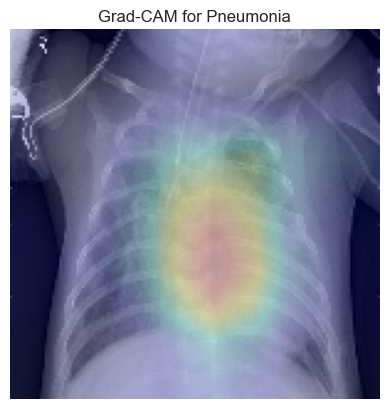

In [158]:
img2, orig_gray2 = preprocess_image(os.path.join('chest_xray', 'test', 'PNEUMONIA', 'person1_virus_6.jpeg'))
pred2 = model.predict(img2)
print(f"Predicted class: {pred2[0]}")
cam2 = compute_gradcam(model, img2, last_conv_layer)
orig_rgb2 = np.stack([orig_gray2]*3, axis=-1)
display_gradcam(cam2, orig_rgb2, title="Grad-CAM for Pneumonia")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
Predicted class: [0.5589921]
Loss: 0.5589920878410339


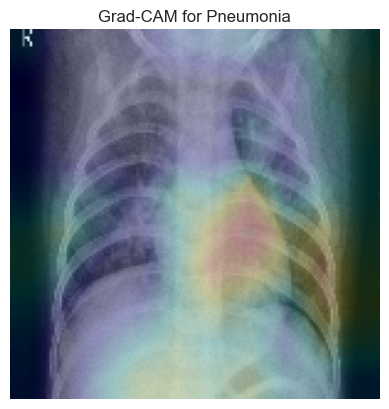

In [159]:
img2, orig_gray2 = preprocess_image(os.path.join('chest_xray', 'test', 'PNEUMONIA', 'person50_virus_102.jpeg'))
pred2 = model.predict(img2)
print(f"Predicted class: {pred2[0]}")
cam2 = compute_gradcam(model, img2, last_conv_layer)
orig_rgb2 = np.stack([orig_gray2]*3, axis=-1)
display_gradcam(cam2, orig_rgb2, title="Grad-CAM for Pneumonia")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Predicted class: [0.46730572]
Loss: 0.4673057496547699


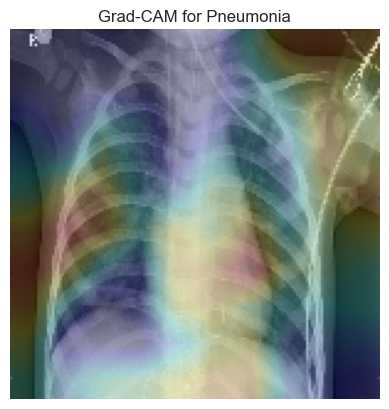

In [160]:
img3, orig_gray3 = preprocess_image(os.path.join('chest_xray', 'test', 'PNEUMONIA', 'person138_bacteria_657.jpeg'))
pred3 = model.predict(img3)
print(f"Predicted class: {pred3[0]}")
cam3 = compute_gradcam(model, img3, last_conv_layer)
orig_rgb3 = np.stack([orig_gray3]*3, axis=-1)
display_gradcam(cam3, orig_rgb3, title="Grad-CAM for Pneumonia")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Predicted class: [0.9791812]
Loss: 0.979181170463562


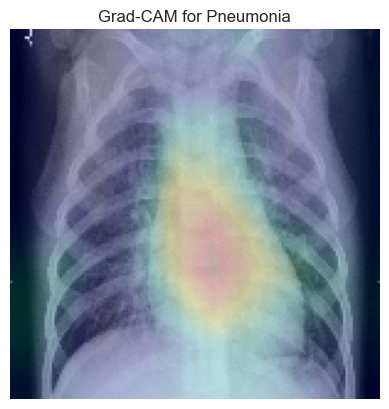

In [161]:
img4, orig_gray4 = preprocess_image(os.path.join('chest_xray', 'test', 'PNEUMONIA', 'person1640_virus_2839.jpeg'))
pred4 = model.predict(img4)
print(f"Predicted class: {pred4[0]}")
cam4 = compute_gradcam(model, img4, last_conv_layer)
orig_rgb4 = np.stack([orig_gray4]*3, axis=-1)
display_gradcam(cam4, orig_rgb4, title="Grad-CAM for Pneumonia")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
Predicted class: [0.9475252]
Loss: 0.9475252032279968


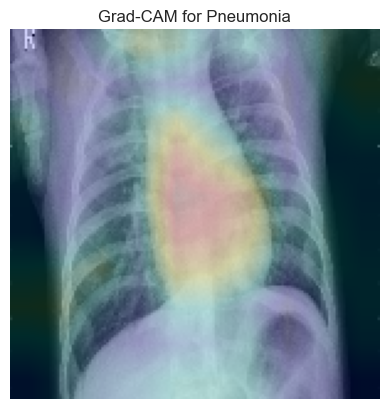

In [162]:
img, orig_gray = preprocess_image(os.path.join('chest_xray', 'test', 'PNEUMONIA', 'person1662_virus_2875.jpeg'))
pred = model.predict(img)
print(f"Predicted class: {pred[0]}")
cam = compute_gradcam(model, img, last_conv_layer)
orig_rgb = np.stack([orig_gray]*3, axis=-1)
display_gradcam(cam, orig_rgb, title="Grad-CAM for Pneumonia")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Predicted class: [0.99978447]
Loss: 0.9997844696044922


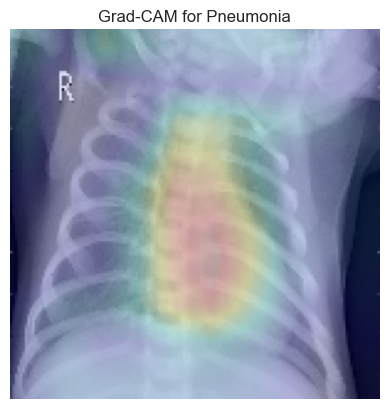

In [59]:
img6, orig_gray6 = preprocess_image(os.path.join('chest_xray', 'test', 'PNEUMONIA', 'person1685_virus_2903.jpeg'))
pred6 = model.predict(img6)
print(f"Predicted class: {pred6[0]}")
cam6 = compute_gradcam(model, img6, last_conv_layer)
orig_rgb6 = np.stack([orig_gray6]*3, axis=-1)
display_gradcam(cam6, orig_rgb6, title="Grad-CAM for Pneumonia")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
Predicted class: [0.72217304]
Loss: 0.7221730351448059


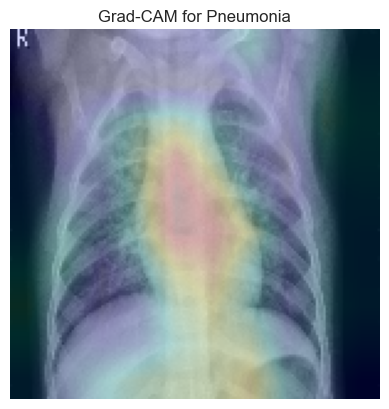

In [60]:
img6, orig_gray6 = preprocess_image(os.path.join('chest_xray', 'test', 'PNEUMONIA', 'person76_virus_138.jpeg'))
pred6 = model.predict(img6)
print(f"Predicted class: {pred6[0]}")
cam6 = compute_gradcam(model, img6, last_conv_layer)
orig_rgb6 = np.stack([orig_gray6]*3, axis=-1)
display_gradcam(cam6, orig_rgb6, title="Grad-CAM for Pneumonia")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
Predicted class: [0.00501636]
Loss: 0.005016356706619263


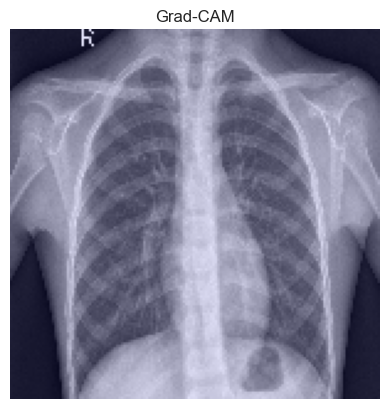

In [61]:
img, orig_gray = preprocess_image(os.path.join('chest_xray', 'test', 'NORMAL', 'IM-0001-0001.jpeg'))

pred = model.predict(img)
print(f"Predicted class: {pred[0]}")
cam = compute_gradcam(model, img, last_conv_layer)
orig_rgb = np.stack([orig_gray]*3, axis=-1)
display_gradcam(cam, orig_rgb)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
Predicted class: [0.00883275]
Loss: 0.008832748979330063


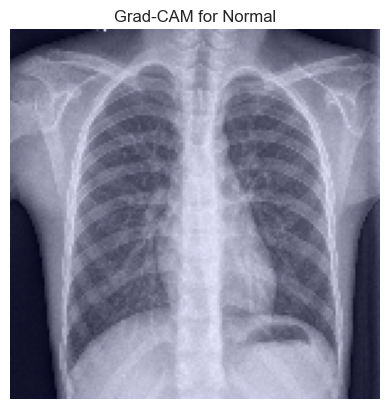

In [62]:
img5, orig_gray5 = preprocess_image(os.path.join('chest_xray', 'test', 'NORMAL', 'IM-0031-0001.jpeg'))
pred5 = model.predict(img5)
print(f"Predicted class: {pred5[0]}")
cam5 = compute_gradcam(model, img5, last_conv_layer)
orig_rgb5 = np.stack([orig_gray5]*3, axis=-1)
display_gradcam(cam5, orig_rgb5, title="Grad-CAM for Normal")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Predicted class: [7.555855e-05]
Loss: 7.555854972451925e-05


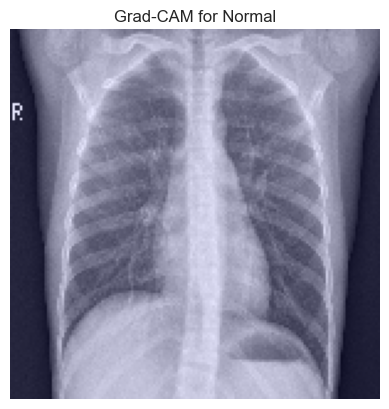

In [63]:
img, orig_gray = preprocess_image(os.path.join('chest_xray', 'test', 'NORMAL', 'IM-0003-0001.jpeg'))
pred = model.predict(img)
print(f"Predicted class: {pred[0]}")
cam = compute_gradcam(model, img, last_conv_layer)
orig_rgb = np.stack([orig_gray]*3, axis=-1)
display_gradcam(cam, orig_rgb, title="Grad-CAM for Normal")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
Predicted class: [0.0064578]
Loss: 0.006457800045609474


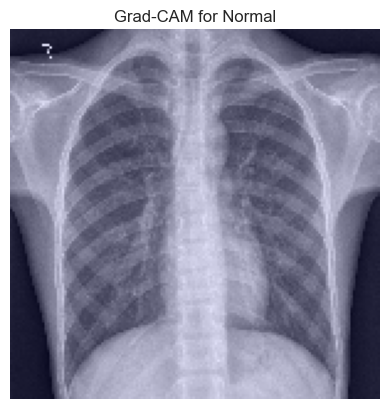

In [64]:
img, orig_gray = preprocess_image(os.path.join('chest_xray', 'test', 'NORMAL', 'IM-0005-0001.jpeg'))
pred = model.predict(img)
print(f"Predicted class: {pred[0]}")
cam = compute_gradcam(model, img, last_conv_layer)
orig_rgb = np.stack([orig_gray]*3, axis=-1)
display_gradcam(cam, orig_rgb, title="Grad-CAM for Normal")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
Predicted class: [0.00867693]
Loss: 0.008676929399371147


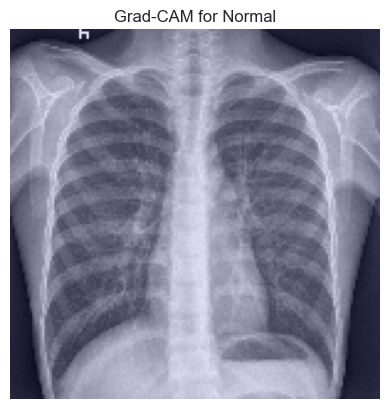

In [65]:
img, orig_gray = preprocess_image(os.path.join('chest_xray', 'test', 'NORMAL', 'IM-0007-0001.jpeg'))
pred = model.predict(img)
print(f"Predicted class: {pred[0]}")
cam = compute_gradcam(model, img, last_conv_layer)
orig_rgb = np.stack([orig_gray]*3, axis=-1)
display_gradcam(cam, orig_rgb, title="Grad-CAM for Normal")

# Q5: Data Randomization Test

In [125]:
y_train_rand = np.random.permutation(y_train)  # shuffle labels
y_train_rand
# save y_train_rand to a file
np.save('y_train_rand.npy', y_train_rand)

In [127]:
model_ran = Sequential()
model_ran.add(Conv2D(32, (3,3), padding='same', activation='relu', input_shape=(150,150,1)))
model_ran.add(BatchNormalization())
model_ran.add(MaxPool2D((2,2), padding='same'))

model_ran.add(Conv2D(64, (3,3), padding='same', activation='relu'))
# Dropout removed
model_ran.add(BatchNormalization())
model_ran.add(MaxPool2D((2,2), padding='same'))

model_ran.add(Conv2D(64, (3,3), padding='same', activation='relu'))
model_ran.add(BatchNormalization())
model_ran.add(MaxPool2D((2,2), padding='same'))

model_ran.add(Conv2D(128, (3,3), padding='same', activation='relu'))
# Dropout removed
model_ran.add(BatchNormalization())
model_ran.add(MaxPool2D((2,2), padding='same'))

model_ran.add(Conv2D(256, (3,3), padding='same', activation='relu'))
# Dropout removed
model_ran.add(BatchNormalization())
model_ran.add(MaxPool2D((2,2), padding='same'))

model_ran.add(Flatten())
model_ran.add(Dense(128, activation='relu'))
# Dropout removed
model_ran.add(Dense(1, activation='sigmoid'))

# Compile with Adam
model_ran.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
model_ran.summary()


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_10 (Conv2D)              │ (None, 150, 150, 32)   │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_10          │ (None, 150, 150, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_10 (MaxPooling2D) │ (None, 75, 75, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_11 (Conv2D)              │ (None, 75, 75, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_11          │ (None, 75, 75, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_11 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_12 (Conv2D)              │ (None, 38, 38, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_12          │ (None, 38, 38, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_12 (MaxPooling2D) │ (None, 19, 19, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_13 (Conv2D)              │ (None, 19, 19, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_13          │ (None, 19, 19, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_13 (MaxPooling2D) │ (None, 10, 10, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_14 (Conv2D)              │ (None, 10, 10, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_14          │ (None, 10, 10, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_14 (MaxPooling2D) │ (None, 5, 5, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 6400)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 128)            │       819,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,246,401 (4.75 MB)

 Trainable params: 1,245,313 (4.75 MB)

 Non-trainable params: 1,088 (4.25 KB)

In [128]:
bool_train_ran = True
if bool_train_ran:
    model_ran.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    history = model_ran.fit(x_train, y_train_rand, epochs=50, batch_size=32, shuffle=True)
    print(f"Final train acc: {history.history['accuracy'][-1]:.3f}")
    model_ran.save('part2_q5_cnn_model_ran_labels_2.h5')

Epoch 1/50
163/163 ━━━━━━━━━━━━━━━━━━━━ 60s 353ms/step - accuracy: 0.6759 - loss: 1.1104
Epoch 2/50
163/163 ━━━━━━━━━━━━━━━━━━━━ 58s 356ms/step - accuracy: 0.7347 - loss: 0.5889
Epoch 3/50
163/163 ━━━━━━━━━━━━━━━━━━━━ 58s 354ms/step - accuracy: 0.7448 - loss: 0.5663
Epoch 4/50
163/163 ━━━━━━━━━━━━━━━━━━━━ 59s 360ms/step - accuracy: 0.7440 - loss: 0.5641
Epoch 5/50
163/163 ━━━━━━━━━━━━━━━━━━━━ 58s 356ms/step - accuracy: 0.7363 - loss: 0.5668
Epoch 6/50
163/163 ━━━━━━━━━━━━━━━━━━━━ 60s 365ms/step - accuracy: 0.7470 - loss: 0.5579
Epoch 7/50
163/163 ━━━━━━━━━━━━━━━━━━━━ 58s 357ms/step - accuracy: 0.7423 - loss: 0.5441
Epoch 8/50
163/163 ━━━━━━━━━━━━━━━━━━━━ 58s 358ms/step - accuracy: 0.7387 - loss: 0.5502
Epoch 9/50
163/163 ━━━━━━━━━━━━━━━━━━━━ 59s 359ms/step - accuracy: 0.7500 - loss: 0.5321
Epoch 10/50
163/163 ━━━━━━━━━━━━━━━━━━━━ 58s 356ms/step - accuracy: 0.7393 - loss: 0.5344
Epoch 11/50
163/163 ━━━━━━━━━━━━━━━━━━━━ 58s 356ms/step - accuracy: 0.7473 - loss: 0.5099
Epoch 12/50
163/163

Final train acc: 0.998


In [ ]:
bool_train_ran_2 = False
if bool_train_ran_2:
    model_ran.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    trained_model_rand = model_ran.fit(datagen.flow(x_train,y_train_rand, batch_size = 32) ,epochs = 50, validation_data = datagen.flow(x_val, y_val) ,callbacks = [learning_rate_reduction])
    model_ran.save('part2_q5_cnn_model_ran_labels.h5')


Epoch 1/50


C:\Users\salom\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\losses\losses.py:33: SyntaxWarning: In loss categorical_crossentropy, expected y_pred.shape to be (batch_size, num_classes) with num_classes > 1. Received: y_pred.shape=(None, 1). Consider using 'binary_crossentropy' if you only have 2 classes.
  return self.fn(y_true, y_pred, **self._fn_kwargs)


163/163 ━━━━━━━━━━━━━━━━━━━━ 63s 358ms/step - accuracy: 0.5108 - loss: 0.0000e+00 - val_accuracy: 0.5000 - val_loss: 0.0000e+00 - learning_rate: 0.0010
Epoch 2/50
163/163 ━━━━━━━━━━━━━━━━━━━━ 62s 377ms/step - accuracy: 0.2582 - loss: 0.0000e+00 - val_accuracy: 0.5000 - val_loss: 0.0000e+00 - learning_rate: 0.0010
Epoch 3/50
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step - accuracy: 0.2464 - loss: 0.0000e+00
Epoch 3: ReduceLROnPlateau reducing learning rate to 0.0003000000142492354.
163/163 ━━━━━━━━━━━━━━━━━━━━ 62s 378ms/step - accuracy: 0.2464 - loss: 0.0000e+00 - val_accuracy: 0.5000 - val_loss: 0.0000e+00 - learning_rate: 0.0010
Epoch 4/50
163/163 ━━━━━━━━━━━━━━━━━━━━ 62s 381ms/step - accuracy: 0.2504 - loss: 0.0000e+00 - val_accuracy: 0.5000 - val_loss: 0.0000e+00 - learning_rate: 3.0000e-04
Epoch 5/50
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step - accuracy: 0.2542 - loss: 0.0000e+00
Epoch 5: ReduceLROnPlateau reducing learning rate to 9.000000427477062e-05.
163/163 ━━━━━━━━━━━━━━━━━━━━ 6

In [132]:
y_pred_ran = (model_ran.predict(x_test) > 0.5).astype("int32")  # Thresholding for binary classification
# Create a histogram of model_ran.predict(x_test)
predictions_ran = model_ran.predict(x_test)

20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 64ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 61ms/step


In [133]:
loss, accuracy = model_ran.evaluate(x_test, y_test)
f1_ran = f1_score(y_test, y_pred_ran)
balanced_accuracy_ran = balanced_accuracy_score(y_test, y_pred_ran)
print("F1 score of the model is - " , f1_ran)
print("Accuracy of the model is - " , accuracy)
print("Balanced Accuracy of the model is - " , balanced_accuracy_ran, "%")

20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 60ms/step - accuracy: 0.3502 - loss: 6.0797
F1 score of the model is -  0.7298170075349839
Accuracy of the model is -  0.5977563858032227
Balanced Accuracy of the model is -  0.5072649572649572 %


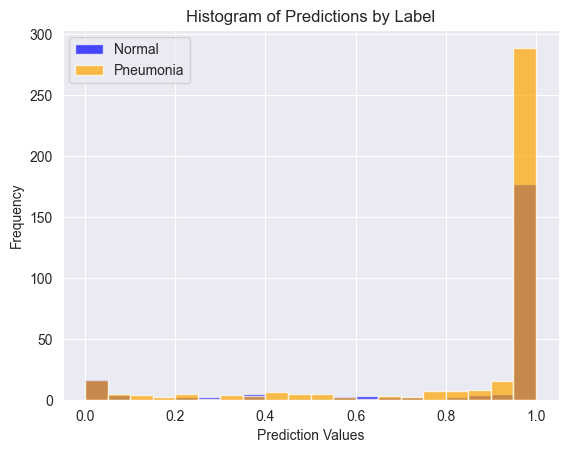

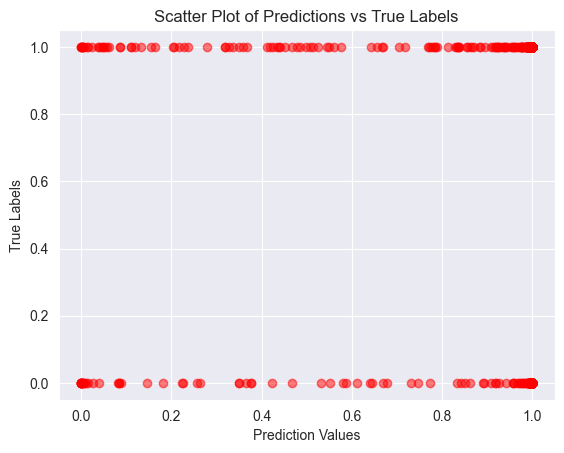

In [134]:
plot_predictions(predictions = predictions_ran, y_test= y_test)

# Implementing Saliency Methods

##  Integrated Gradients (IG)

In [163]:

def integrated_gradients(model, img, target_class_idx, baseline=None, steps=50):
    if baseline is None:
        baseline = np.zeros_like(img)
    # Scale image and baseline to float
    img = img.astype(np.float32)
    baseline = baseline.astype(np.float32)
    # 1. Generate interpolation path
    interpolated_imgs = [(baseline + (i/steps)*(img - baseline)) for i in range(steps+1)]
    interpolated_imgs = np.array(interpolated_imgs, dtype=np.float32)
    # 2. Compute gradients at each step
    grads = []
    for interp_img in interpolated_imgs:
        interp_img_tensor = tf.convert_to_tensor(interp_img[None, ...])  # shape: (1, H, W, C)
        with tf.GradientTape() as tape:
            tape.watch(interp_img_tensor)
            pred = model(interp_img_tensor)
            class_score = pred[0, 0]
        grad = tape.gradient(class_score, interp_img_tensor)[0]  # remove batch dim
        grads.append(grad.numpy())
    grads = np.array(grads, dtype=np.float32)
    # 3. Average gradients (trapezoidal rule)
    avg_grads = (grads[:-1] + grads[1:]) / 2.0
    avg_grad = np.mean(avg_grads, axis=0)
    # 4. Integrated gradients
    integrated_grad = (img - baseline) * avg_grad
    return integrated_grad  # same shape as input image

In [164]:
# Normalize for display
def normalize(arr):
    arr = np.abs(arr)
    arr = arr / (np.max(arr) + 1e-8)
    return arr

In [165]:
img = x_test[0]
label = y_test[0]
baseline = np.zeros_like(img) # create a black baseline of same shape
preds_rand = model.predict(np.expand_dims(img, axis=0))
preds_rand = model.predict(np.expand_dims(img, axis=0))
print(preds_rand)
target_class_rand = int(preds_rand> 0.5)
print(target_class_rand)
print(img)
label

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
[[0.00501636]]
0
[[[0.14117647]
  [0.1254902 ]
  [0.1254902 ]
  ...
  [0.1254902 ]
  [0.1372549 ]
  [0.12941176]]

 [[0.11764706]
  [0.11764706]
  [0.11764706]
  ...
  [0.11764706]
  [0.11372549]
  [0.12156863]]

 [[0.13333333]
  [0.1254902 ]
  [0.1254902 ]
  ...
  [0.1254902 ]
  [0.1254902 ]
  [0.1254902 ]]

 ...

 [[0.12156863]
  [0.10588235]
  [0.11372549]
  ...
  [0.11764706]
  [0.12941176]
  [0.1372549 ]]

 [[0.11764706]
  [0.11372549]
  [0.10196078]
  ...
  [0.13333333]
  [0.13333333]
  [0.1254902 ]]

 [[0.11372549]
  [0.10980392]
  [0.11372549]
  ...
  [0.12156863]
  [0.11372549]
  [0.14117647]]]


C:\Users\salom\AppData\Local\Temp\ipykernel_2320\2128184625.py:7: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  target_class_rand = int(preds_rand> 0.5)


np.int64(0)

In [166]:
def compare_ig_maps(model1, model2, imgs, labels=None, class_names=None, num_images=5, return_maps=True):
    """
    Compare IG maps for model1 and model2 on multiple input images.
    Optionally return the IG maps for further analysis.

    Returns (if return_maps=True):
        ig_maps_model1: list of IG maps from model1
        ig_maps_model2: list of IG maps from model2
    """
    ig_maps_model1 = []
    ig_maps_model2 = []

    for i in range(num_images):
        img = imgs[i]
        
        # Predict class for model1
        preds1 = model1.predict(img[None, ...])
        class_idx1 = int(preds1 > 0.5)

        print(f"Model 1 Prediction: {preds1}, Class Index: {class_idx1}")
        
        # Predict class for model2
        preds2 = model2.predict(img[None, ...])
        class_idx2 = int(preds2 > 0.5)

        print(f"Model 1 Prediction: {preds2}, Class Index: {class_idx2}")

        # Compute IG maps
        ig_map1 = integrated_gradients(model1, img, class_idx1)
        ig_map2 = integrated_gradients(model2, img, class_idx2)

        ig_maps_model1.append(ig_map1)
        ig_maps_model2.append(ig_map2)

        # Plot
        plt.figure(figsize=(10, 4))

        plt.subplot(1, 3, 1)
        plt.imshow(img.squeeze(), cmap='gray')
        title = f"Image #{i}"
        if class_names and labels is not None:
            true_class = class_names[labels[i]]
            title += f" (True: {true_class})"
        plt.title(title)
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(img.squeeze(), cmap='gray')
        plt.imshow(normalize(ig_map1), cmap='jet', alpha=0.5)
        name1 = class_names[class_idx1] if class_names else f"Class {class_idx1}"
        plt.title(f"IG: Original Model\nPred: {name1}")
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(img.squeeze(), cmap='gray')
        plt.imshow(normalize(ig_map2), cmap='jet', alpha=0.5)
        name2 = class_names[class_idx2] if class_names else f"Class {class_idx2}"
        plt.title(f"IG: Random Model\nPred: {name2}")
        plt.axis('off')

        plt.tight_layout()
        plt.savefig(f"comparison_image_{i}.png", dpi=300, bbox_inches='tight')
        plt.show()
    
    if return_maps:
        return ig_maps_model1, ig_maps_model2

624
[0 0 0 0 0]
[1 1 1 1]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
Model 1 Prediction: [[0.00501636]], Class Index: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
Model 1 Prediction: [[1.]], Class Index: 1


C:\Users\salom\AppData\Local\Temp\ipykernel_2320\2288310803.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  class_idx1 = int(preds1 > 0.5)
C:\Users\salom\AppData\Local\Temp\ipykernel_2320\2288310803.py:24: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  class_idx2 = int(preds2 > 0.5)


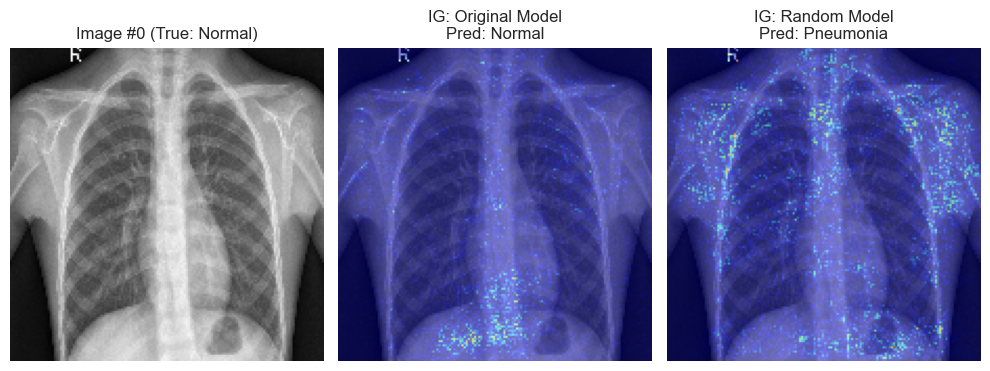

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Model 1 Prediction: [[7.555855e-05]], Class Index: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
Model 1 Prediction: [[0.999963]], Class Index: 1


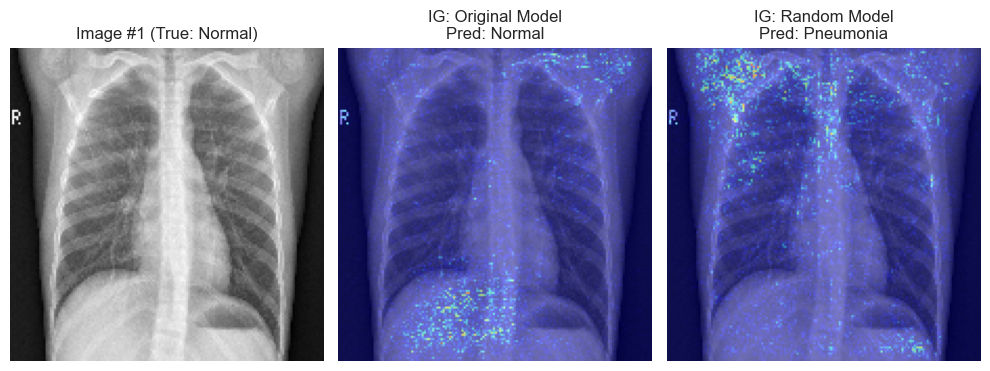

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
Model 1 Prediction: [[0.0064578]], Class Index: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
Model 1 Prediction: [[0.9999999]], Class Index: 1


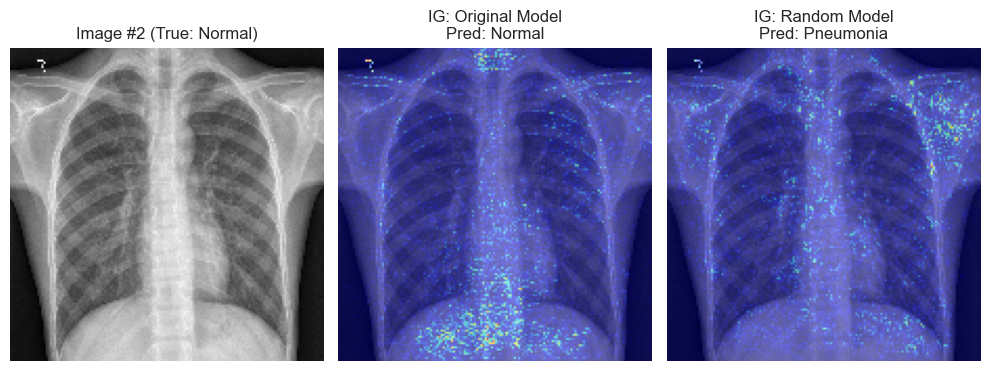

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
Model 1 Prediction: [[0.01034089]], Class Index: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
Model 1 Prediction: [[0.36542466]], Class Index: 0


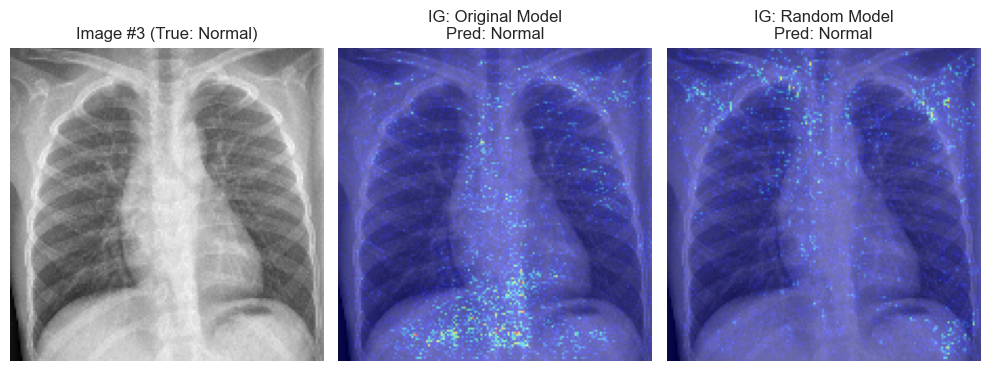

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
Model 1 Prediction: [[0.00867693]], Class Index: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
Model 1 Prediction: [[0.9999987]], Class Index: 1


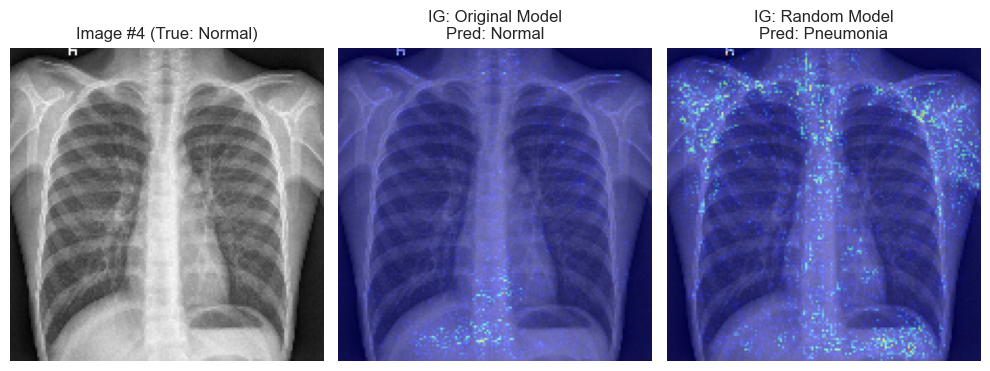

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
Model 1 Prediction: [[0.99999994]], Class Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Model 1 Prediction: [[0.99999774]], Class Index: 1


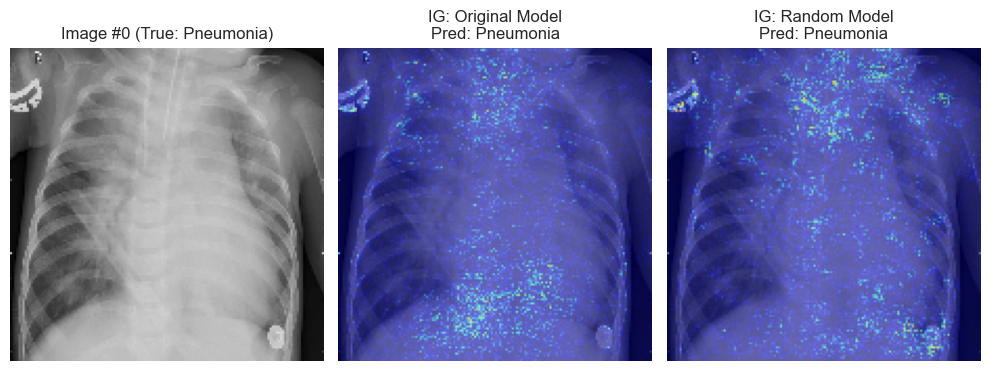

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
Model 1 Prediction: [[0.99931395]], Class Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
Model 1 Prediction: [[0.99999994]], Class Index: 1


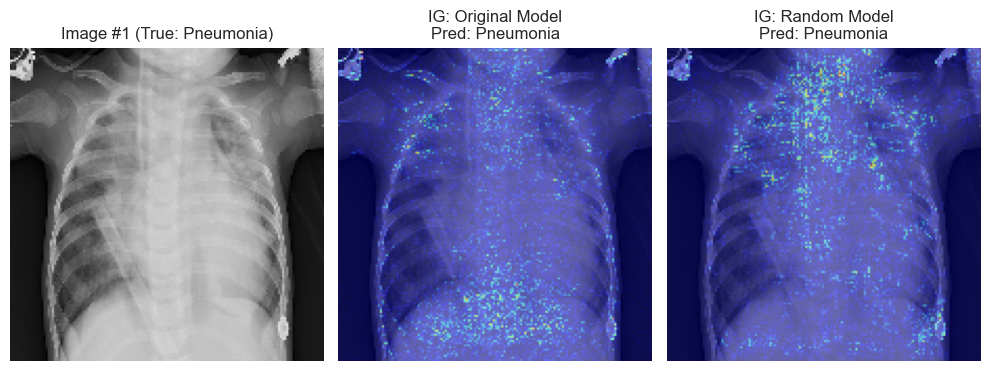

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
Model 1 Prediction: [[0.9999699]], Class Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
Model 1 Prediction: [[0.9999605]], Class Index: 1


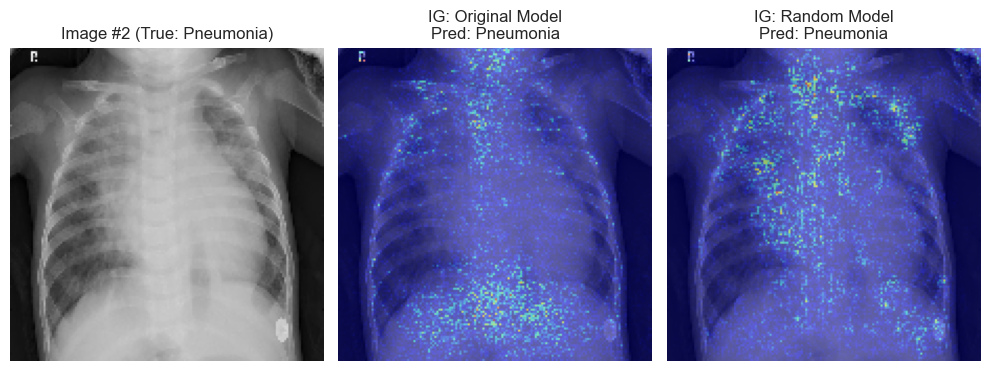

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
Model 1 Prediction: [[0.98605084]], Class Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Model 1 Prediction: [[0.99642444]], Class Index: 1


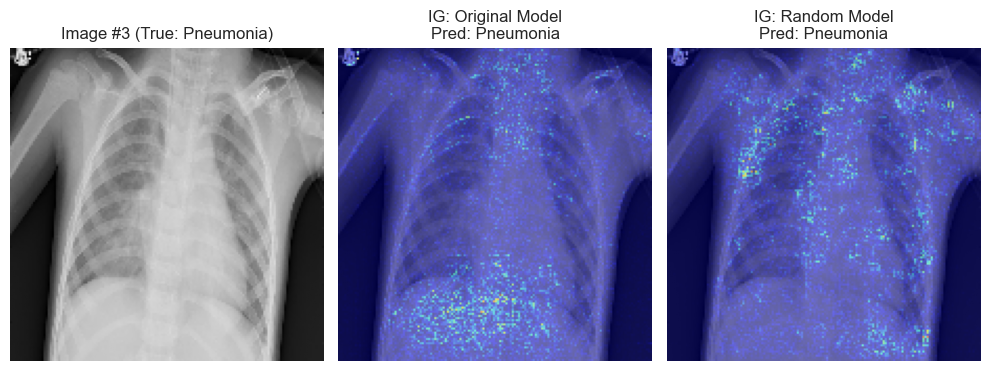

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Model 1 Prediction: [[0.80893236]], Class Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
Model 1 Prediction: [[0.9998738]], Class Index: 1


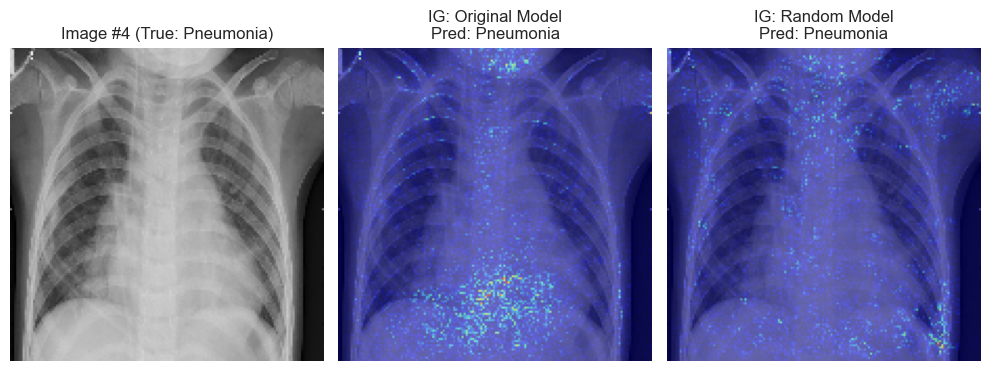

[1 1 1 1 1]
[[1]
 [1]
 [1]
 [1]
 [1]]
[[1]
 [1]
 [1]
 [1]
 [1]]


([array([[[ 2.2863609e-05],
          [ 8.8128007e-05],
          [-7.1709053e-07],
          ...,
          [ 1.2650282e-06],
          [ 9.9013050e-06],
          [ 5.3554404e-06]],
  
         [[ 3.5030465e-05],
          [ 4.1036110e-05],
          [-8.9133748e-05],
          ...,
          [ 1.7307870e-05],
          [ 1.6237103e-05],
          [ 6.9356502e-06]],
  
         [[-5.5589502e-05],
          [ 7.3781885e-05],
          [ 7.6558543e-05],
          ...,
          [ 3.1906566e-05],
          [ 6.2752326e-07],
          [ 3.5243516e-05]],
  
         ...,
  
         [[ 1.7154908e-06],
          [ 7.5954136e-05],
          [ 1.7202969e-04],
          ...,
          [-3.5253644e-05],
          [ 1.2222059e-04],
          [-2.1807480e-05]],
  
         [[-2.9016849e-06],
          [ 8.2253195e-05],
          [-9.9346005e-05],
          ...,
          [ 1.0362381e-05],
          [ 6.2380910e-05],
          [-6.1242795e-06]],
  
         [[-1.0434549e-05],
          [ 4.522949

In [167]:
print(y_test.size)
print(y_test[0:5])
print(y_test[620:624])
class_names = ["Normal", "Pneumonia"]
x_test_subset = x_test[0:5]  # Select first 5 images for comparison
label_subset = y_test[0:5]  # Corresponding labels for the selected images
ig_maps = compare_ig_maps(model, model_ran, x_test_subset, labels=label_subset, class_names=class_names, num_images=5)
x_test_subset = x_test[618:623]  # Select first 5 images for comparison
label_subset = y_test[618:623]  # Corresponding labels for the selected images
ig_maps = compare_ig_maps(model, model_ran, x_test_subset, labels=label_subset, class_names=class_names, num_images=5)
print(label_subset)
print(y_pred[618:623])
print(y_pred_ran[618:623])
ig_maps

In [90]:
def evaluate_saliency_similarity(model1, model2, imgs, num_samples=None, steps=50, verbose=False):
    """
    Compare Integrated Gradients saliency maps between two models using SSIM and Spearman correlation.

    Args:
        model1: Original model (trained on true labels)
        model2: Random-label model
        imgs: Numpy array of images (e.g., test set)
        num_samples: Number of images to use (default: all)
        steps: Number of interpolation steps for IG
        verbose: If True, prints individual scores

    Returns:
        ssim_scores: List of SSIM scores
        spearman_scores: List of Spearman rank correlations
    """
    if num_samples is None:
        num_samples = len(imgs)

    ssim_scores = []
    spearman_scores = []

    for i in range(num_samples):
        img = imgs[i]

        # Predict class for both models
        class1 = np.argmax(model1.predict(img[None, ...]))
        class2 = np.argmax(model2.predict(img[None, ...]))

        # Compute IG saliency maps
        ig1 = integrated_gradients(model1, img, class1, steps=steps)
        ig2 = integrated_gradients(model2, img, class2, steps=steps)

        # Normalize and flatten
        ig1_flat = normalize(ig1).flatten()
        ig2_flat = normalize(ig2).flatten()

        # SSIM
        score_ssim = ssim(ig1.squeeze(), ig2.squeeze(), data_range=1.0)
        ssim_scores.append(score_ssim)

        # Spearman correlation
        score_spearman = spearmanr(ig1_flat, ig2_flat).correlation
        spearman_scores.append(score_spearman)

        if verbose:
            print(f"Image {i}: SSIM={score_ssim:.3f}, Spearman={score_spearman:.3f}")

    # Summary
    print(f"\n--- Saliency Similarity Summary ---")
    print(f"Average SSIM: {np.mean(ssim_scores):.3f}")
    print(f"Average Spearman Correlation: {np.mean(spearman_scores):.3f}")

    return ssim_scores, spearman_scores


In [168]:
ssim_scores, spearman_scores = evaluate_saliency_similarity(model, model_ran, x_test_subset, verbose=True)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
Image 0: SSIM=0.975, Spearman=0.257
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
Image 1: SSIM=0.983, Spearman=0.450
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
Image 2: SSIM=0.947, Spearman=0.403
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
Image 3: SSIM=0.912, Spearman=0.377
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
Image 4: SSIM=0.999, Spearman=0.233

--- Saliency Similarity Summary ---
Average SSIM: 0.963
Average Spearman Correlation: 0.344


GRAD CAM, RANDOM GUESSING

In [177]:
last_conv_layer = 'conv2d_14' 

In [181]:
from glob import glob

def run_gradcam_on_image(filename, model, last_conv_layer):
    img, orig_gray = preprocess_image(filename)
    pred = model.predict(img)
    print(f"File: {os.path.basename(filename)} | Predicted class: {pred[0]}")
    cam = compute_gradcam(model, img, last_conv_layer)
    orig_rgb = np.stack([orig_gray] * 3, axis=-1)
    display_gradcam(cam, orig_rgb, title=f"Grad-CAM for {os.path.basename(filename)}")

# Define directories
normal_dir = os.path.join('chest_xray', 'test', 'NORMAL')
pneumonia_dir = os.path.join('chest_xray', 'test', 'PNEUMONIA')

# Get first 20 image file paths from each directory
normal_images = sorted(glob(os.path.join(normal_dir, '*.jpeg')))[:20]
pneumonia_images = sorted(glob(os.path.join(pneumonia_dir, '*.jpeg')))[:20]

# Combine the two lists
all_images = normal_images + pneumonia_images


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
File: IM-0001-0001.jpeg | Predicted class: [1.]
Loss: 1.0


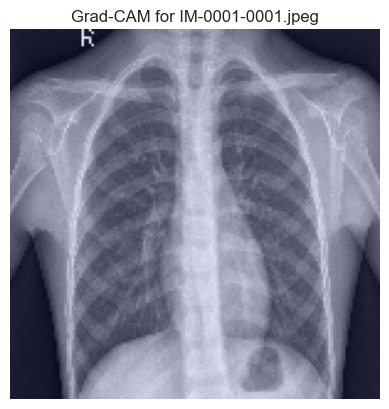

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
File: IM-0003-0001.jpeg | Predicted class: [0.999963]
Loss: 0.9999629855155945


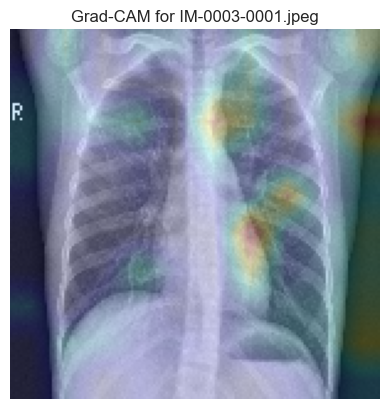

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
File: IM-0005-0001.jpeg | Predicted class: [0.9999999]
Loss: 0.9999998807907104


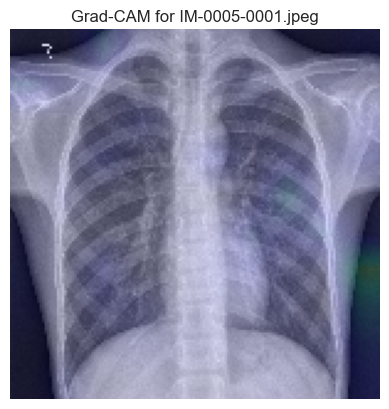

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
File: IM-0006-0001.jpeg | Predicted class: [0.36542466]
Loss: 0.3654246926307678


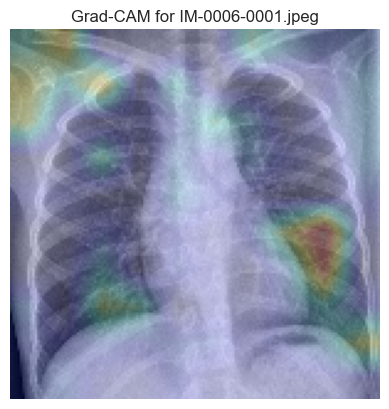

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
File: IM-0007-0001.jpeg | Predicted class: [0.9999987]
Loss: 0.9999986886978149


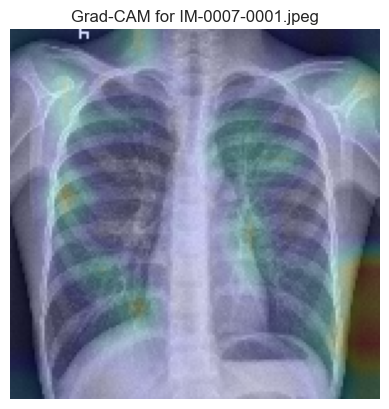

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
File: IM-0009-0001.jpeg | Predicted class: [0.99998546]
Loss: 0.9999854564666748


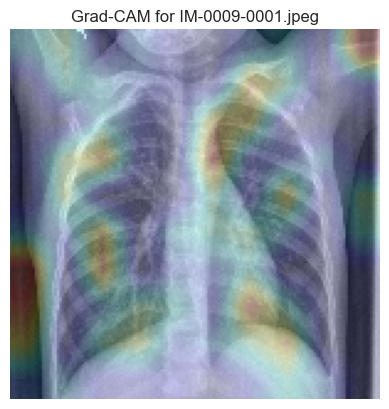

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
File: IM-0010-0001.jpeg | Predicted class: [0.99252146]
Loss: 0.9925214648246765


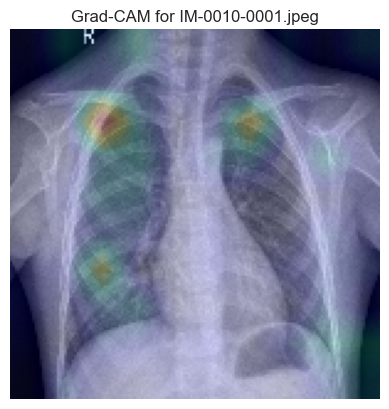

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
File: IM-0011-0001-0001.jpeg | Predicted class: [0.99999964]
Loss: 0.9999996423721313


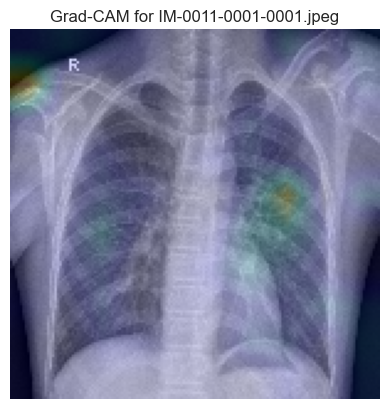

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
File: IM-0011-0001-0002.jpeg | Predicted class: [0.8522599]
Loss: 0.8522598743438721


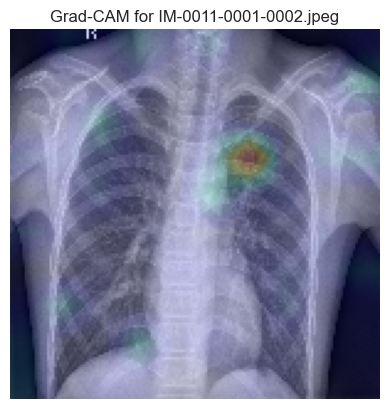

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
File: IM-0011-0001.jpeg | Predicted class: [0.99999547]
Loss: 0.9999954700469971


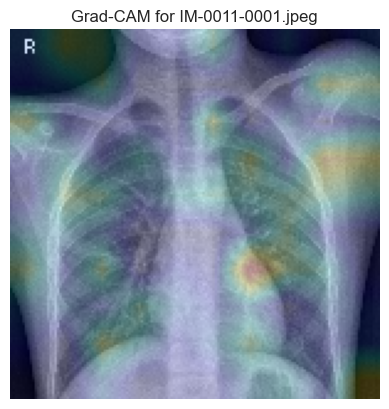

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
File: IM-0013-0001.jpeg | Predicted class: [0.9999782]
Loss: 0.9999781847000122


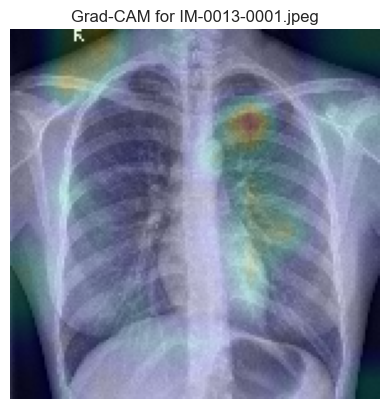

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
File: IM-0015-0001.jpeg | Predicted class: [0.9999939]
Loss: 0.9999939203262329


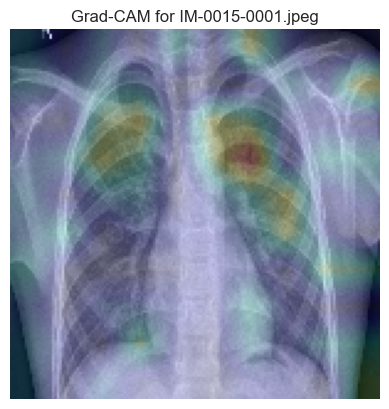

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
File: IM-0016-0001.jpeg | Predicted class: [0.976509]
Loss: 0.9765089750289917


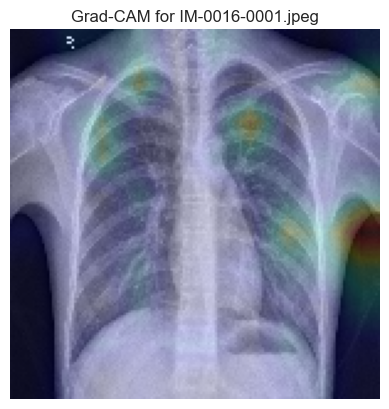

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
File: IM-0017-0001.jpeg | Predicted class: [0.99999964]
Loss: 0.9999996423721313


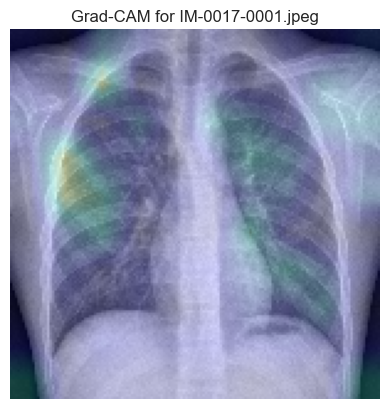

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
File: IM-0019-0001.jpeg | Predicted class: [1.]
Loss: 1.0


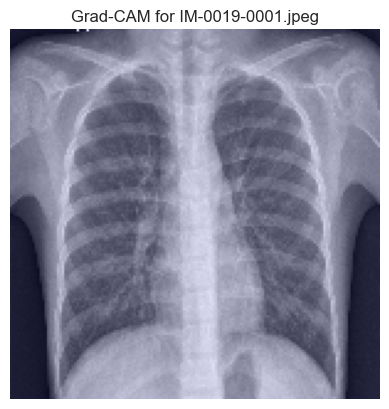

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
File: IM-0021-0001.jpeg | Predicted class: [0.99966633]
Loss: 0.9996663331985474


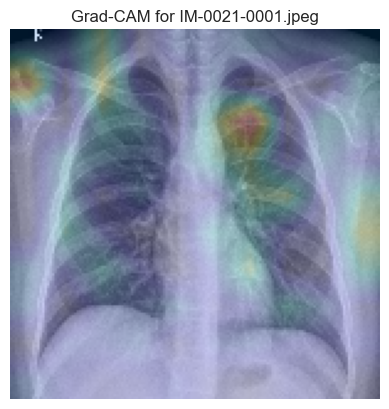

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
File: IM-0022-0001.jpeg | Predicted class: [0.9999956]
Loss: 0.9999955892562866


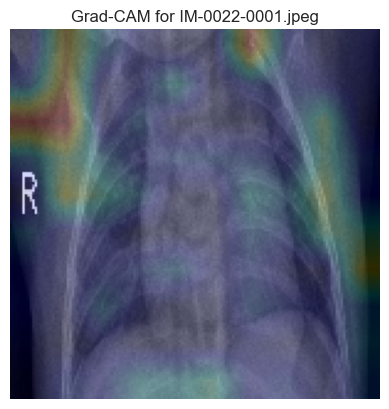

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
File: IM-0023-0001.jpeg | Predicted class: [0.9998028]
Loss: 0.999802827835083


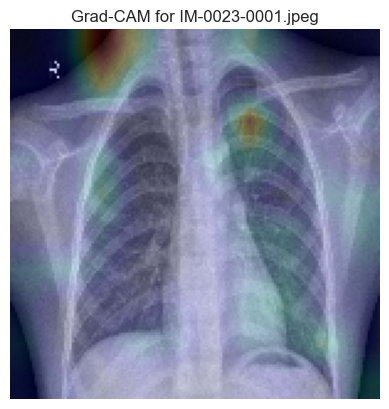

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
File: IM-0025-0001.jpeg | Predicted class: [0.98973393]
Loss: 0.9897339344024658


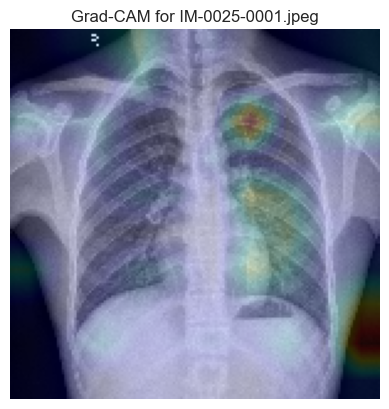

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
File: IM-0027-0001.jpeg | Predicted class: [0.9969199]
Loss: 0.9969198703765869


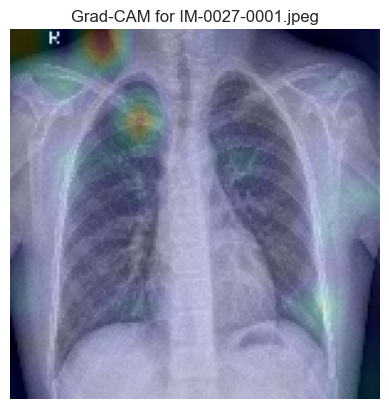

In [184]:
# Run Grad-CAM on each image
for img_path in normal_images:
    run_gradcam_on_image(img_path, model=model_ran, last_conv_layer=last_conv_layer) 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
File: person100_bacteria_475.jpeg | Predicted class: [0.92452204]
Loss: 0.9245220422744751


C:\Users\salom\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\models\functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor_426']
Received: inputs=Tensor(shape=(1, 150, 150, 1))
  warnings.warn(msg)


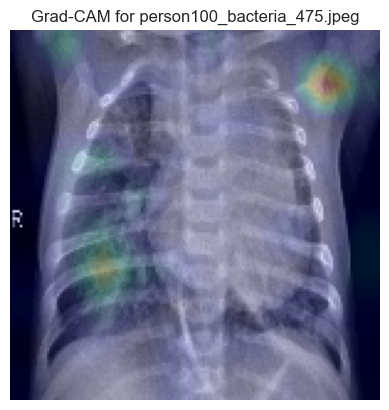

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
File: person100_bacteria_477.jpeg | Predicted class: [0.99736613]
Loss: 0.9973661303520203


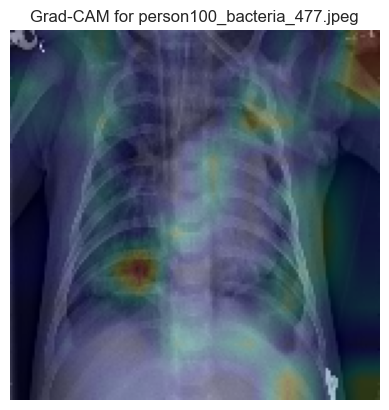

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
File: person100_bacteria_478.jpeg | Predicted class: [0.9997334]
Loss: 0.9997333884239197


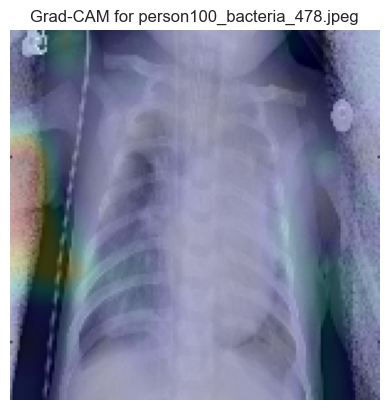

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
File: person100_bacteria_479.jpeg | Predicted class: [0.05778061]
Loss: 0.05778060853481293


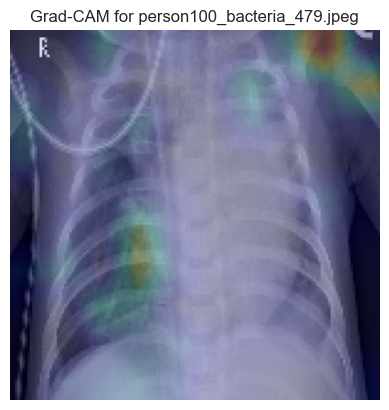

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
File: person100_bacteria_480.jpeg | Predicted class: [0.04814458]
Loss: 0.04814458638429642


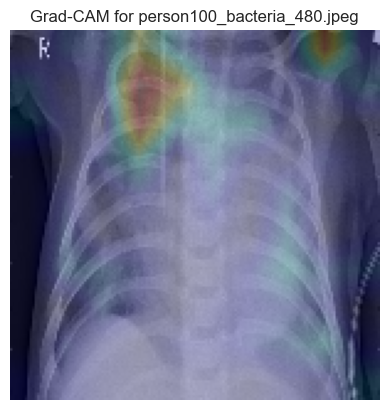

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
File: person100_bacteria_481.jpeg | Predicted class: [0.97283953]
Loss: 0.9728395342826843


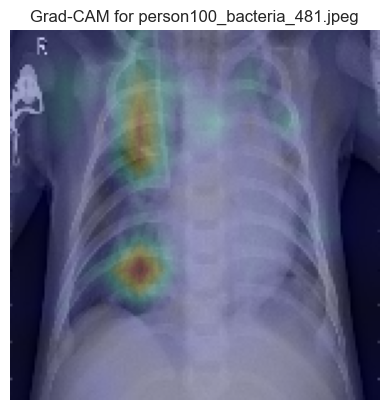

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
File: person100_bacteria_482.jpeg | Predicted class: [0.4793094]
Loss: 0.47930940985679626


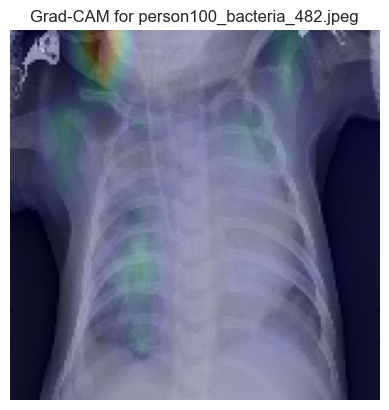

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
File: person101_bacteria_483.jpeg | Predicted class: [0.9999961]
Loss: 0.9999961256980896


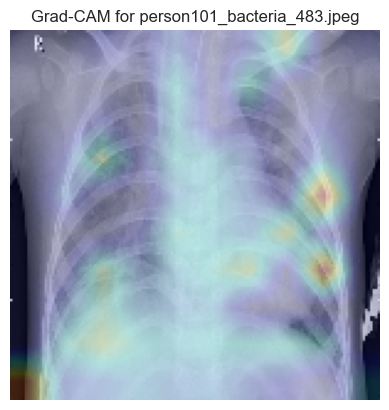

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
File: person101_bacteria_484.jpeg | Predicted class: [0.99999493]
Loss: 0.9999949336051941


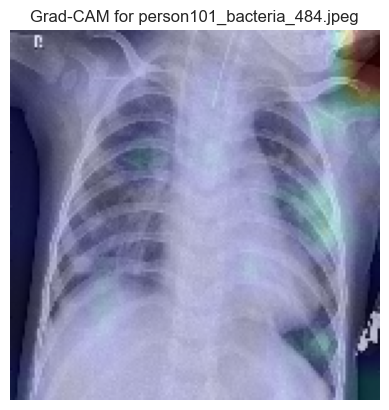

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
File: person101_bacteria_485.jpeg | Predicted class: [0.9999999]
Loss: 0.9999998807907104


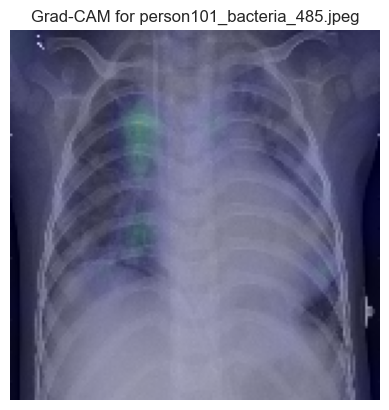

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
File: person101_bacteria_486.jpeg | Predicted class: [0.95484024]
Loss: 0.9548402428627014


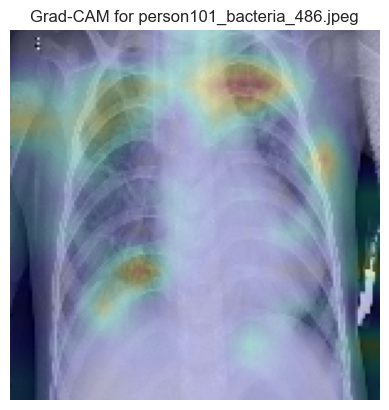

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
File: person102_bacteria_487.jpeg | Predicted class: [1.]
Loss: 1.0


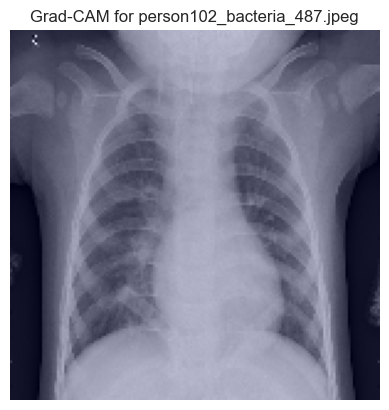

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
File: person103_bacteria_488.jpeg | Predicted class: [0.9999661]
Loss: 0.9999660849571228


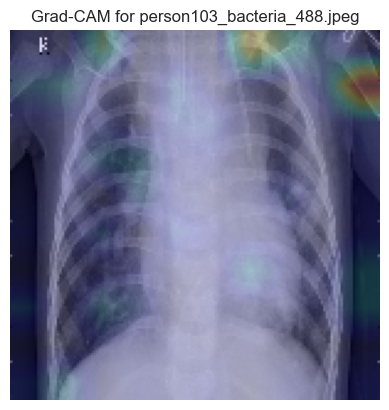

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
File: person103_bacteria_489.jpeg | Predicted class: [0.03983755]
Loss: 0.0398375429213047


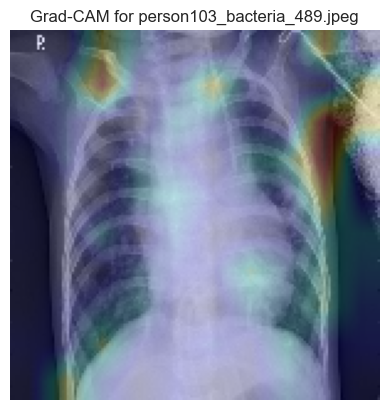

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
File: person103_bacteria_490.jpeg | Predicted class: [0.00025379]
Loss: 0.0002537912514526397


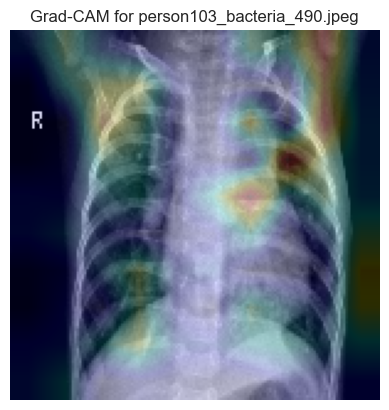

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
File: person104_bacteria_491.jpeg | Predicted class: [0.998804]
Loss: 0.998803973197937


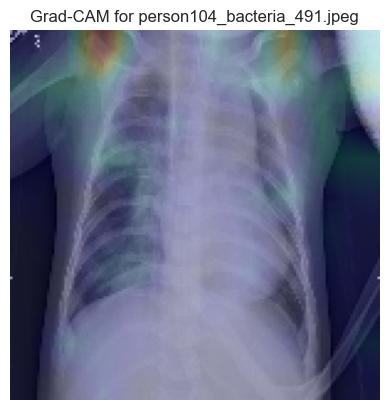

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
File: person104_bacteria_492.jpeg | Predicted class: [0.21674795]
Loss: 0.21674798429012299


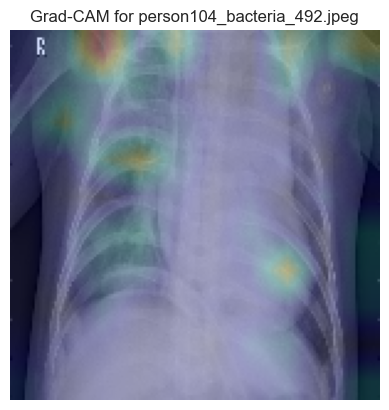

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
File: person108_bacteria_504.jpeg | Predicted class: [0.9993341]
Loss: 0.9993340969085693


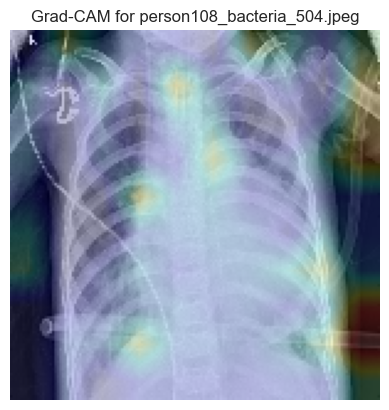

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
File: person108_bacteria_506.jpeg | Predicted class: [0.9994288]
Loss: 0.9994288086891174


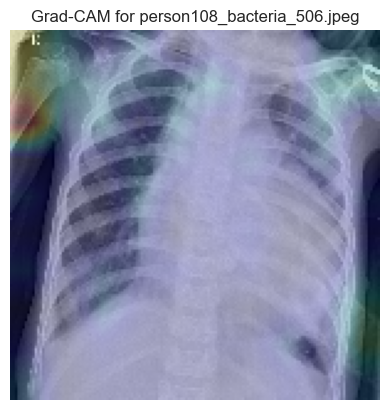

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
File: person108_bacteria_507.jpeg | Predicted class: [0.31826082]
Loss: 0.3182608187198639


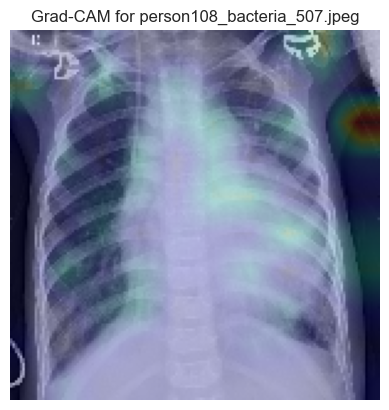

In [185]:
for img_path in pneumonia_images:
    run_gradcam_on_image(img_path, model=model_ran, last_conv_layer=last_conv_layer) 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
File: person100_bacteria_475.jpeg | Predicted class: [0.8673725]
Loss: 0.8673725128173828


C:\Users\salom\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\models\functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['input_layer']
Received: inputs=Tensor(shape=(1, 150, 150, 1))
  warnings.warn(msg)


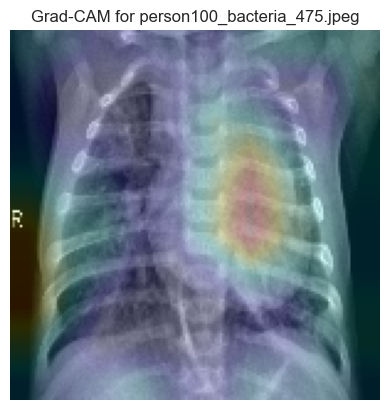

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
File: person100_bacteria_477.jpeg | Predicted class: [0.9922081]
Loss: 0.9922081828117371


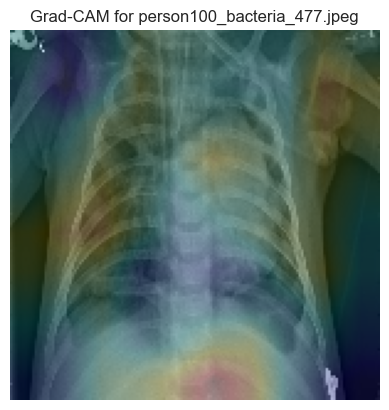

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
File: person100_bacteria_478.jpeg | Predicted class: [0.9999977]
Loss: 0.9999976754188538


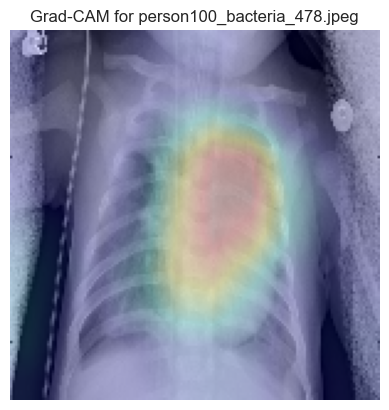

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
File: person100_bacteria_479.jpeg | Predicted class: [1.]
Loss: 1.0


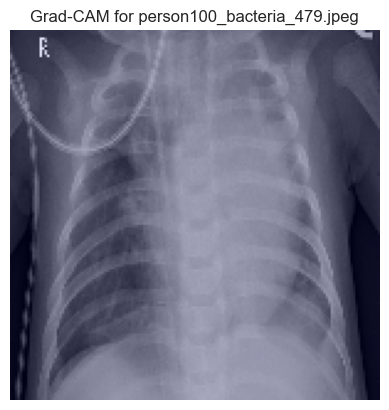

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
File: person100_bacteria_480.jpeg | Predicted class: [1.]
Loss: 1.0


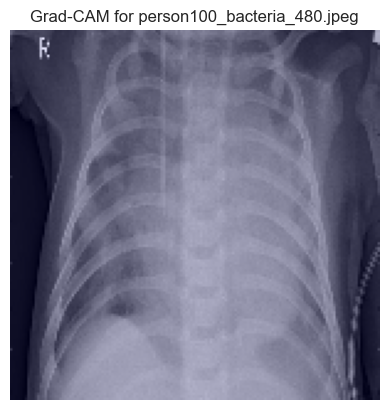

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
File: person100_bacteria_481.jpeg | Predicted class: [1.]
Loss: 1.0


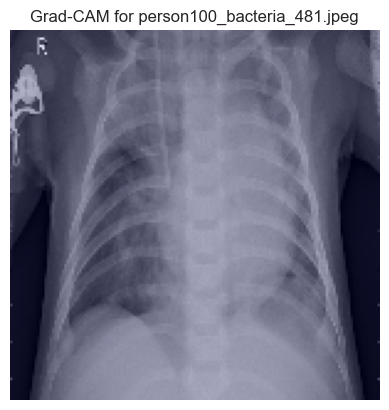

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
File: person100_bacteria_482.jpeg | Predicted class: [0.99999964]
Loss: 0.9999996423721313


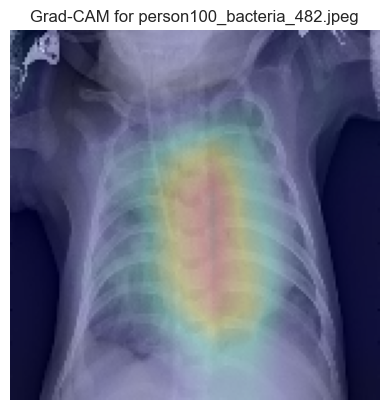

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
File: person101_bacteria_483.jpeg | Predicted class: [1.]
Loss: 1.0


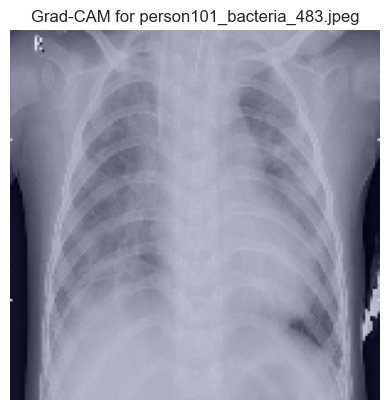

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
File: person101_bacteria_484.jpeg | Predicted class: [0.1552735]
Loss: 0.15527349710464478


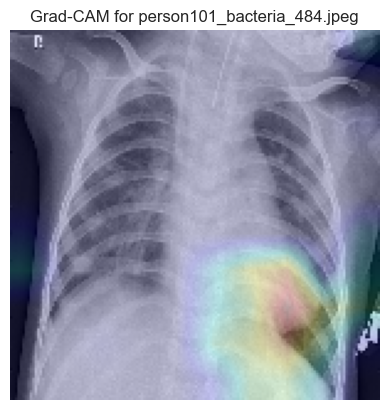

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
File: person101_bacteria_485.jpeg | Predicted class: [1.]
Loss: 1.0


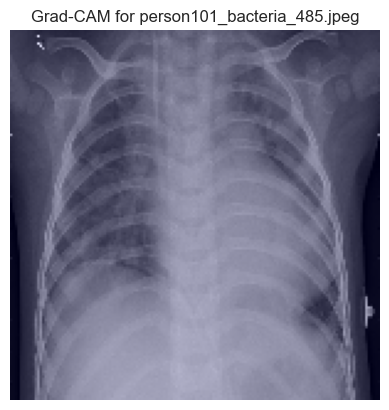

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
File: person101_bacteria_486.jpeg | Predicted class: [1.]
Loss: 1.0


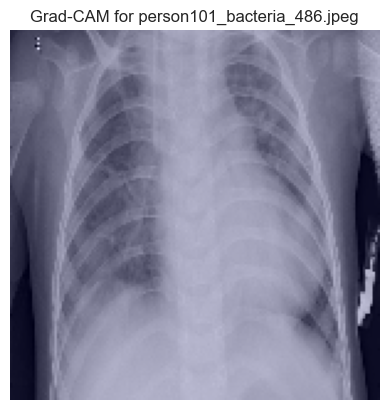

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
File: person102_bacteria_487.jpeg | Predicted class: [0.9014101]
Loss: 0.9014101028442383


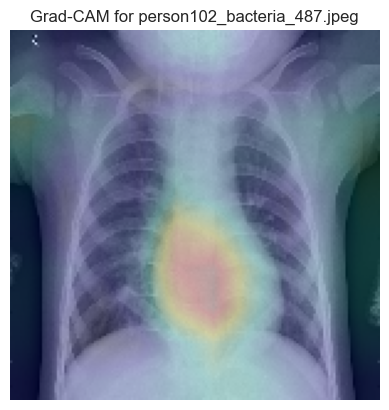

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
File: person103_bacteria_488.jpeg | Predicted class: [0.9999984]
Loss: 0.9999983906745911


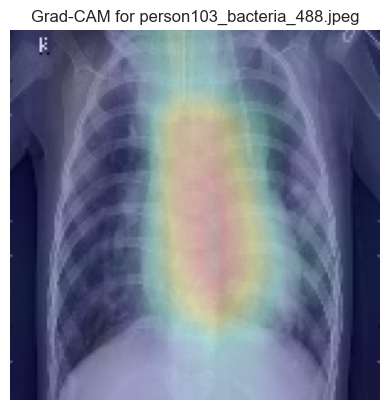

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
File: person103_bacteria_489.jpeg | Predicted class: [0.98978543]
Loss: 0.9897854328155518


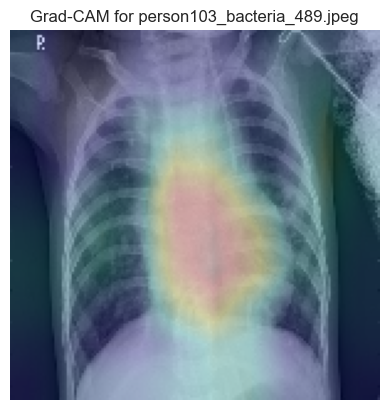

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
File: person103_bacteria_490.jpeg | Predicted class: [0.82918835]
Loss: 0.829188346862793


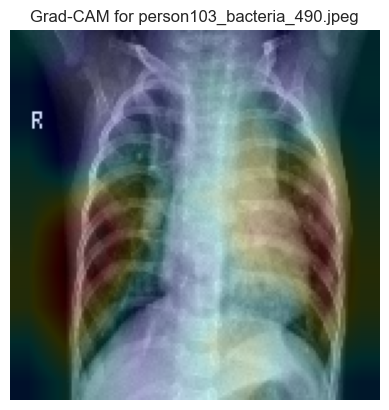

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
File: person104_bacteria_491.jpeg | Predicted class: [0.99999946]
Loss: 0.999999463558197


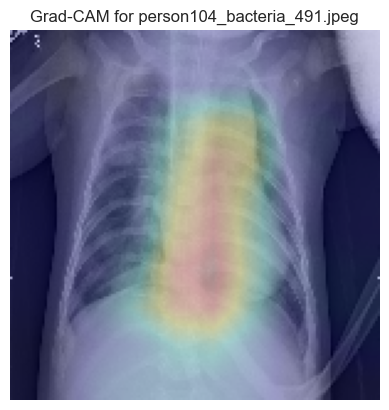

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
File: person104_bacteria_492.jpeg | Predicted class: [1.]
Loss: 1.0


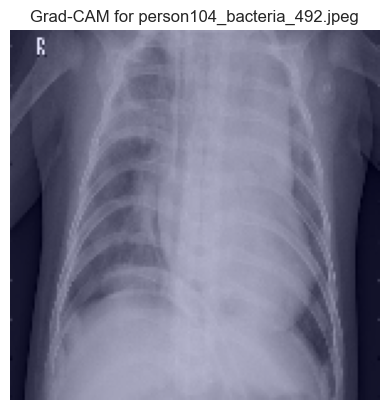

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
File: person108_bacteria_504.jpeg | Predicted class: [0.90510094]
Loss: 0.90510094165802


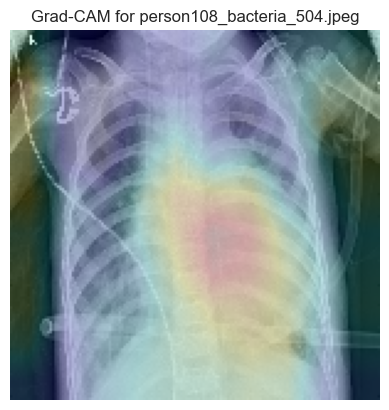

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
File: person108_bacteria_506.jpeg | Predicted class: [0.93252015]
Loss: 0.9325201511383057


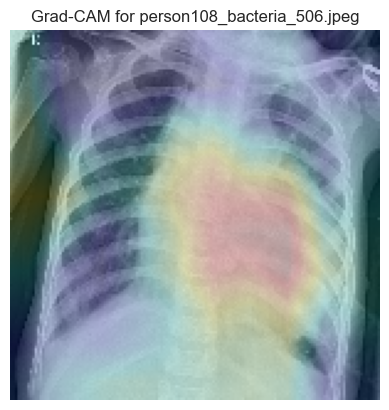

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
File: person108_bacteria_507.jpeg | Predicted class: [0.99814016]
Loss: 0.9981401562690735


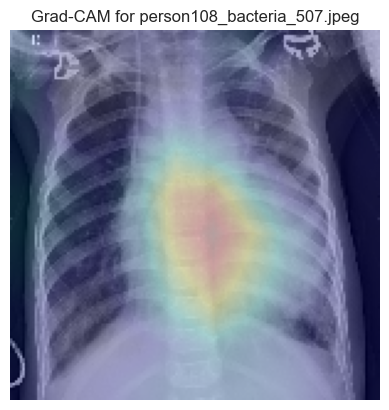

In [187]:
last_conv_layer = 'conv2d_4' 
for img_path in pneumonia_images:
    run_gradcam_on_image(img_path, model=model, last_conv_layer=last_conv_layer) 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
File: IM-0001-0001.jpeg | Predicted class: [0.00501636]
Loss: 0.005016356706619263


C:\Users\salom\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\models\functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['input_layer']
Received: inputs=Tensor(shape=(1, 150, 150, 1))
  warnings.warn(msg)


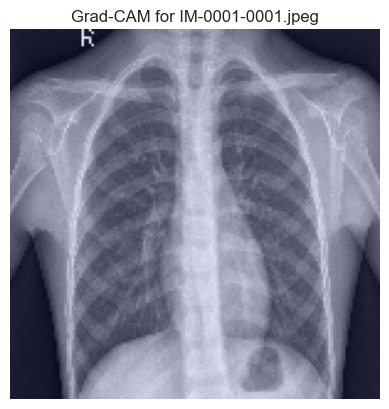

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
File: IM-0003-0001.jpeg | Predicted class: [7.555855e-05]
Loss: 7.555854972451925e-05


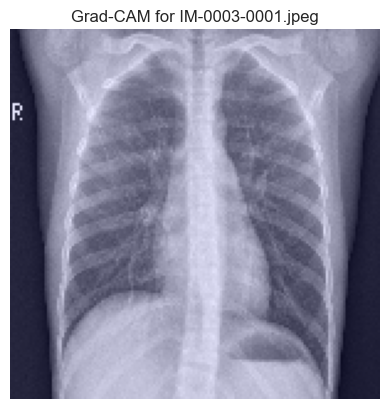

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
File: IM-0005-0001.jpeg | Predicted class: [0.0064578]
Loss: 0.006457800045609474


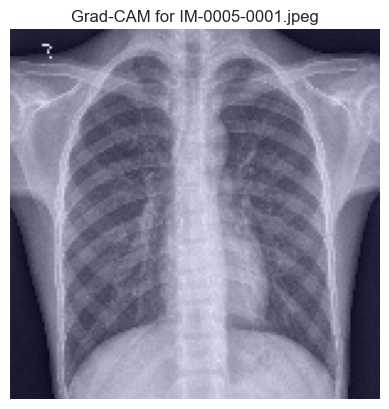

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
File: IM-0006-0001.jpeg | Predicted class: [0.01034089]
Loss: 0.010340891778469086


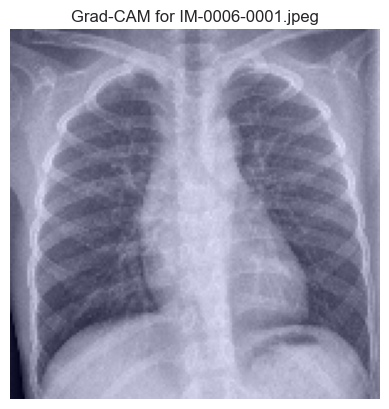

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
File: IM-0007-0001.jpeg | Predicted class: [0.00867693]
Loss: 0.008676929399371147


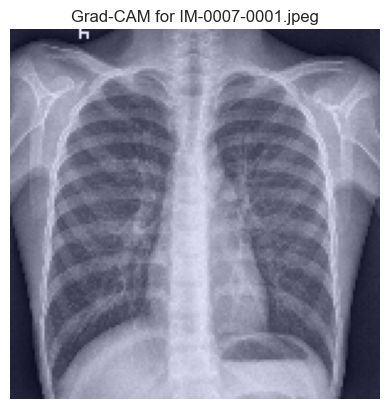

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
File: IM-0009-0001.jpeg | Predicted class: [3.981829e-05]
Loss: 3.981828558607958e-05


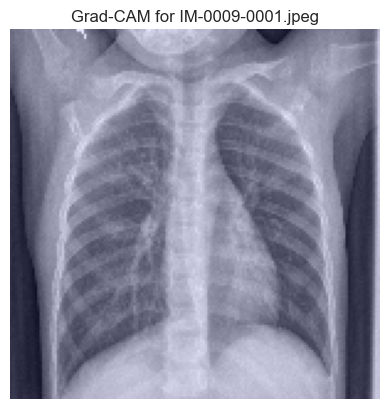

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
File: IM-0010-0001.jpeg | Predicted class: [0.00198033]
Loss: 0.0019803254399448633


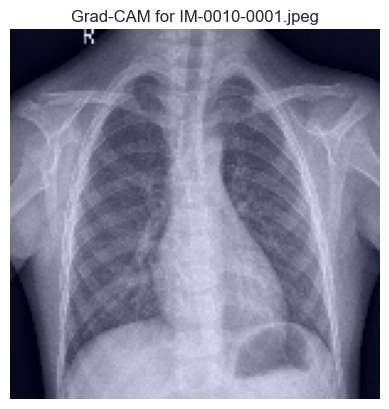

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
File: IM-0011-0001-0001.jpeg | Predicted class: [0.00422274]
Loss: 0.004222744144499302


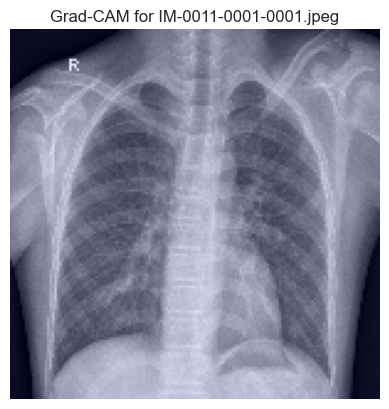

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
File: IM-0011-0001-0002.jpeg | Predicted class: [0.01491547]
Loss: 0.014915469102561474


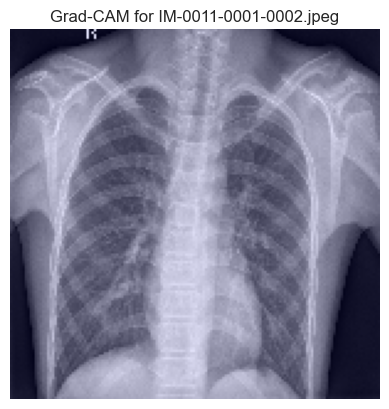

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
File: IM-0011-0001.jpeg | Predicted class: [0.00043642]
Loss: 0.0004364233755040914


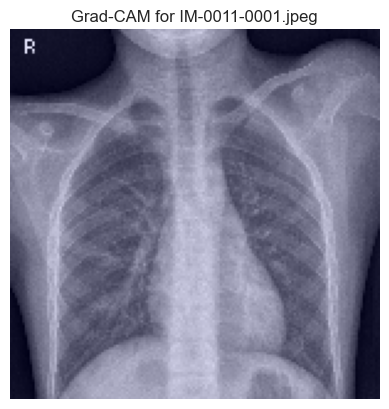

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
File: IM-0013-0001.jpeg | Predicted class: [0.00535171]
Loss: 0.005351714324206114


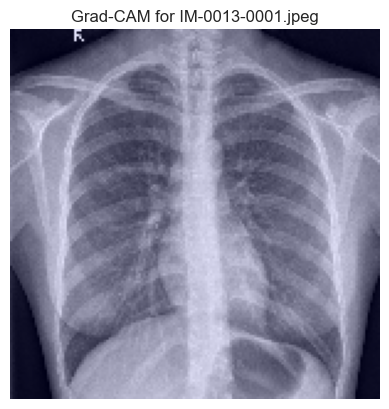

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
File: IM-0015-0001.jpeg | Predicted class: [0.0016197]
Loss: 0.001619701273739338


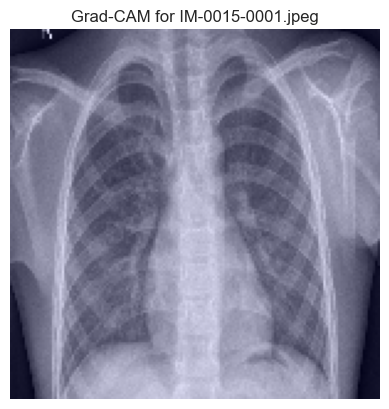

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
File: IM-0016-0001.jpeg | Predicted class: [0.00460194]
Loss: 0.004601945169270039


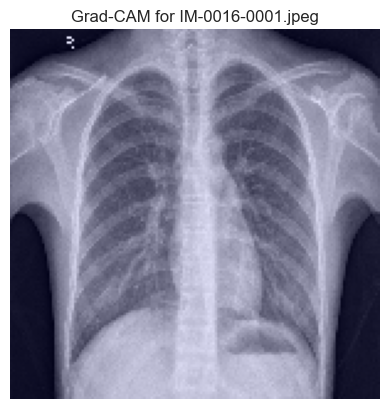

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
File: IM-0017-0001.jpeg | Predicted class: [0.00181236]
Loss: 0.0018123551271855831


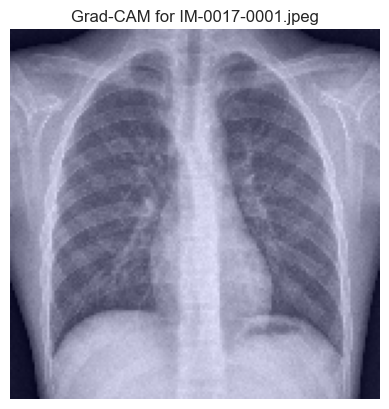

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
File: IM-0019-0001.jpeg | Predicted class: [0.01355443]
Loss: 0.013554433360695839


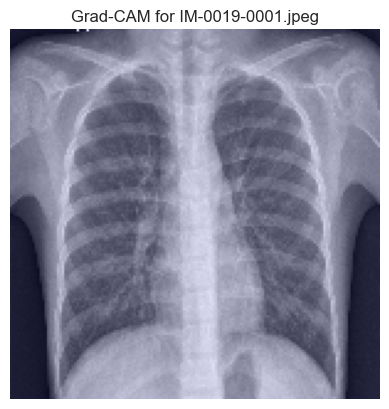

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
File: IM-0021-0001.jpeg | Predicted class: [0.00227678]
Loss: 0.0022767845075577497


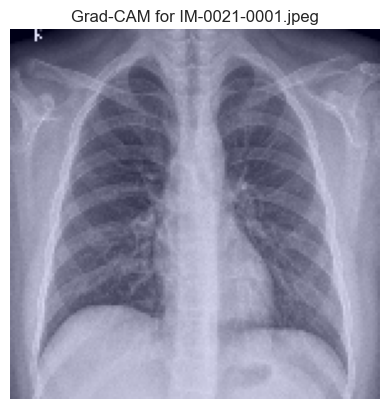

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
File: IM-0022-0001.jpeg | Predicted class: [0.9999958]
Loss: 0.9999958276748657


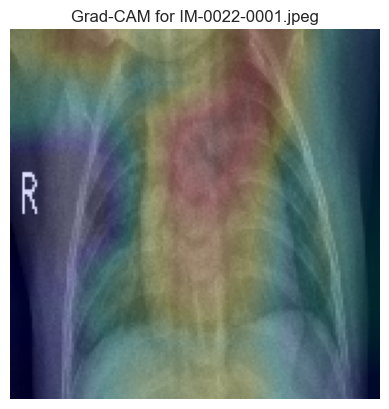

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
File: IM-0023-0001.jpeg | Predicted class: [0.00206031]
Loss: 0.0020603116136044264


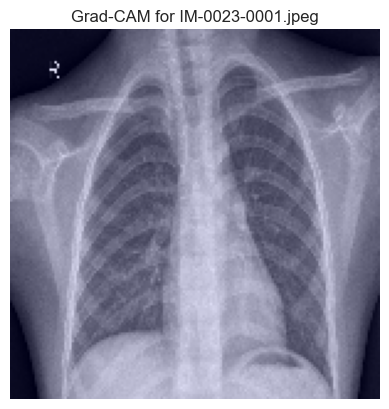

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
File: IM-0025-0001.jpeg | Predicted class: [0.01782143]
Loss: 0.017821433022618294


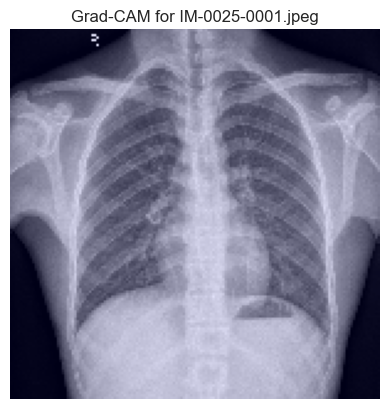

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
File: IM-0027-0001.jpeg | Predicted class: [0.00030656]
Loss: 0.00030656237504445016


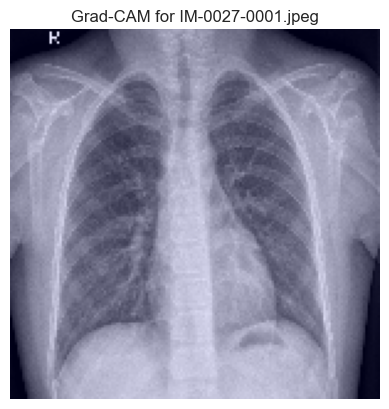

In [188]:
last_conv_layer = 'conv2d_4' 
for img_path in normal_images:
    run_gradcam_on_image(img_path, model=model, last_conv_layer=last_conv_layer) 